# Dataset

In [26]:
import torch

# After training or inference
def clear_gpu_memory():
    torch.cuda.empty_cache()       # Releases unoccupied cached memory
    torch.cuda.ipc_collect()       # Collects inter-process communication artifacts
    print("GPU memory cleared.")

# Usage
# clear_gpu_memory()




In [2]:
import os
import random
import numpy as np
import cv2
import torch
import torch.nn as nn
import torch.optim as optim
import torchvision.transforms as transforms
import matplotlib.pyplot as plt
from torch.utils.data import Dataset, DataLoader
from sklearn.model_selection import train_test_split


In [3]:
# # Dataset path
# # ROOT_DIR = "/home/miglab/Desktop/Duke_Liver/Converted_Liver_DaTA"
# ROOT_DIR = "/mnt/e3dbc9b9-6856-470d-84b1-ff55921cd906/EPS_Liver/Converted_Liver_DaTA"
# IMG_HEIGHT, IMG_WIDTH = 256, 256

# # Lists to store images and masks
# image_paths, mask_paths = [], []

# # Recursively traverse dataset folders
# for main_folder in os.listdir(ROOT_DIR):
#     main_folder_path = os.path.join(ROOT_DIR, main_folder)
    
#     if os.path.isdir(main_folder_path):
#         for subfolder in os.listdir(main_folder_path):
#             subfolder_path = os.path.join(main_folder_path, subfolder)
            
#             img_dir = os.path.join(subfolder_path, "images")
#             mask_dir = os.path.join(subfolder_path, "masks")

#             if os.path.isdir(img_dir) and os.path.isdir(mask_dir):
#                 img_files = sorted(os.listdir(img_dir))
#                 mask_files = sorted(os.listdir(mask_dir))
#                 # print(img_files)
#                 # raise Exception
#                 for img_file, mask_file in zip(img_files, mask_files):
#                     image_paths.append(os.path.join(img_dir, img_file))
#                     mask_paths.append(os.path.join(mask_dir, mask_file))
#                     # print(image_paths)
# print(image_paths[:75])
# # print(mask_paths[:50])
# print(f"Total Images: {len(image_paths)}, Total Masks: {len(mask_paths)}")

# # Split data into train and validation sets
# X_train, X_val, Y_train, Y_val = train_test_split(image_paths, mask_paths, test_size=0.2, random_state=42)
# print(f"Train: {len(X_train)}, Validation: {len(X_val)}")


In [4]:
print('hello')

hello


In [5]:
# import os
# import cv2

# # Define the output folder where new structure will be created
# output_folder = "/mnt/e3dbc9b9-6856-470d-84b1-ff55921cd906/EPS_Medical/Liver_dataset"

# # Define target folders
# leftImg8bit_train = os.path.join(output_folder, "leftImg8bit/train")
# leftImg8bit_val = os.path.join(output_folder, "leftImg8bit/val")
# gtFine_train = os.path.join(output_folder, "gtFine/train")
# gtFine_val = os.path.join(output_folder, "gtFine/val")

# # Create directories if they don't exist
# for folder in [leftImg8bit_train, leftImg8bit_val, gtFine_train, gtFine_val]:
#     os.makedirs(folder, exist_ok=True)

# # Function to generate a unique filename
# def generate_new_filename(original_path, replace_text):
#     parts = original_path.split('/')
#     folder1, folder2, file_name = parts[-4], parts[-3], parts[-1]
#     new_name = f"{folder1}_{folder2}_{replace_text}_{file_name}"
#     return new_name

# # Function to copy, resize, convert to RGB, and rename files
# def copy_resize_and_rename(file_list, destination_folder, replace_text):
#     for file_path in file_list:
#         if not os.path.exists(file_path):  # Skip missing files
#             continue

#         # Load the image in grayscale mode
#         image = cv2.imread(file_path, cv2.IMREAD_GRAYSCALE)
        
#         # Convert grayscale to RGB by duplicating channels
#         rgb_image = cv2.cvtColor(image, cv2.COLOR_GRAY2RGB)
        
#         # Resize using nearest-neighbor interpolation (preserves pixel values)
#         resized_image = cv2.resize(rgb_image, (256, 256), interpolation=cv2.INTER_NEAREST)

#         # Generate new filename
#         new_name = generate_new_filename(file_path, replace_text)
#         new_path = os.path.join(destination_folder, new_name)

#         # Save the resized RGB image
#         cv2.imwrite(new_path, resized_image)

# # Copy, resize, and convert images to RGB
# copy_resize_and_rename(X_train, leftImg8bit_train, "images")
# copy_resize_and_rename(X_val, leftImg8bit_val, "images")

# # Copy and resize masks without conversion to RGB (assuming they remain grayscale)
# copy_resize_and_rename(Y_train, gtFine_train, "masks")
# copy_resize_and_rename(Y_val, gtFine_val, "masks")

# print("Files successfully resized, converted to RGB, and reorganized!")

# import os
# import cv2
# import numpy as np

# # Define the output folder where new structure will be created
# output_folder = "/mnt/e3dbc9b9-6856-470d-84b1-ff55921cd906/EPS_Medical/Liver_dataset"

# # Define target folders
# leftImg8bit_train = os.path.join(output_folder, "leftImg8bit/train")
# leftImg8bit_val = os.path.join(output_folder, "leftImg8bit/val")
# gtFine_train = os.path.join(output_folder, "gtFine/train")
# gtFine_val = os.path.join(output_folder, "gtFine/val")

# # Create directories if they don't exist
# for folder in [leftImg8bit_train, leftImg8bit_val, gtFine_train, gtFine_val]:
#     os.makedirs(folder, exist_ok=True)

# # Function to generate a unique filename
# def generate_new_filename(original_path, replace_text):
#     parts = original_path.split('/')
#     folder1, folder2, file_name = parts[-4], parts[-3], parts[-1]
#     new_name = f"{folder1}_{folder2}_{replace_text}_{file_name}"
#     return new_name

# # Function to copy, resize, and optionally modify image/mask values
# def copy_resize_and_rename(file_list, destination_folder, replace_text):
#     for file_path in file_list:
#         if not os.path.exists(file_path):  # Skip missing files
#             continue

#         # Load the image in grayscale mode
#         image = cv2.imread(file_path, cv2.IMREAD_UNCHANGED)

#         if replace_text == "images":
#             processed_image = image  # Keep grayscale as-is
#         else:
#             # Convert 0 -> 1 (background), 255 -> 2001 (liver)
#             processed_image = np.where(image == 255, 2001, 1).astype(np.uint16)

#         # Resize using nearest-neighbor to preserve label values
#         resized_image = cv2.resize(processed_image, (256, 256), interpolation=cv2.INTER_NEAREST)

#         # Generate new filename
#         new_name = generate_new_filename(file_path, replace_text)
#         new_path = os.path.join(destination_folder, new_name)

#         # Save
#         if replace_text == "images":
#             cv2.imwrite(new_path, resized_image)  # Grayscale, no channel change
#         else:
#             cv2.imwrite(new_path, resized_image)  # Save masks as uint16

# # Copy, resize, and keep grayscale images
# copy_resize_and_rename(X_train, leftImg8bit_train, "images")
# copy_resize_and_rename(X_val, leftImg8bit_val, "images")

# # Copy and resize masks with value modifications
# copy_resize_and_rename(Y_train, gtFine_train, "masks")
# copy_resize_and_rename(Y_val, gtFine_val, "masks")

# print("✅ Files successfully resized, kept in grayscale, and masks remapped and saved!")


In [6]:

# import cv2
# import numpy as np

# # Load the image
# image_path = "/mnt/e3dbc9b9-6856-470d-84b1-ff55921cd906/EPS_Medical/Liver_dataset/leftImg8bit/val/0001_17_images_0020.png"
# image = cv2.imread(image_path, cv2.IMREAD_UNCHANGED)  # Load in original format

# # Print the shape
# print("Image shape:", image.shape)

# # Check if the image is grayscale or RGB
# if len(image.shape) == 2:  # Grayscale image
#     print("The image is grayscale.")
#     unique_values = np.unique(image)
#     print("Unique pixel values:", unique_values)
    
# elif len(image.shape) == 3 and image.shape[2] == 3:  # RGB image
#     print("The image is RGB.")
#     image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Convert from BGR to RGB
#     unique_colors = np.unique(image_rgb.reshape(-1, 3), axis=0)
#     print("Unique colors in the image:", unique_colors)
# else:
#     print("Unknown image format.")

# image_to_save = image


In [7]:
# image_path = "/mnt/e3dbc9b9-6856-470d-84b1-ff55921cd906/EPS_Medical/Liver_dataset/output/cityscapes_panoptic_val/0001_17_masks_0020_panoptic.png"
# image = cv2.imread(image_path, cv2.IMREAD_UNCHANGED) 
# gt_to_save = image


In [8]:
# import cv2
# import numpy as np
# from PIL import Image


# # Load the image
# image_path = "/mnt/e3dbc9b9-6856-470d-84b1-ff55921cd906/EPS_Liver/Liver_dataset_EPS/gtFine/val/0001_34_panoptic_0055.png"
# image = cv2.imread(image_path, cv2.IMREAD_UNCHANGED) 

# print(image.shape)
# # raise Exception
# mask = image == 255
# color = [255, 0, 0]
# pan_format = np.zeros(
#                 (256, 256, 3), dtype=np.uint8
#             )
# pan_format[mask] = color

# area = np.sum(mask) # segment area computation

# # bbox computation for a segment
# hor = np.sum(mask, axis=0)
# hor_idx = np.nonzero(hor)[0]
# x = hor_idx[0]
# width = hor_idx[-1] - x + 1
# vert = np.sum(mask, axis=1)
# vert_idx = np.nonzero(vert)[0]
# y = vert_idx[0]
# height = vert_idx[-1] - y + 1
# bbox = [int(x), int(y), int(width), int(height)]

# import cv2
# import matplotlib.pyplot as plt

# pan_format_cv = np.array(pan_format)
# # cv2.rectangle(pan_format_cv, (bbox[0], bbox[1]), (bbox[2], bbox[3]), (0, 255, 0), 2)
# cv2.rectangle(pan_format_cv, (bbox[0], bbox[1]), (bbox[0] + bbox[2] - 1, bbox[1] + bbox[3] - 1), (0, 255, 0), 2)

# print(bbox)
# # Convert back to PIL image (Optional, if you need to use PIL again)
# pan_format_with_bbox = Image.fromarray(pan_format_cv)

# # Display using Matplotlib (since cv2.imshow() may not work in Ubuntu)
# plt.imshow(pan_format_with_bbox)
# plt.axis("off")  # Hide axes
# plt.show()

# Data Loader

In [1]:
class Config:
    class MODEL_CUSTOM:
        class BACKBONE:
            NAME = 'convnextv2_base'  # Change to another model like 'convnextv2_base'
            LOAD_PRETRAIN = True  # Don't load pre-trained weights
            INPUT_HEIGHT = 256
            INPUT_WIDTH = 256


In [2]:
import os
import json
import torch
import numpy as np
from PIL import Image
from torch.utils.data import Dataset
import torchvision.transforms.functional as F
from detectron2.structures import Instances, BitMasks, Boxes
from torchvision.transforms import functional as TF

In [3]:
def rgb2id(color):
    """ Pass the image from RGB to the instance id value
    See COCO format doc https://cocodataset.org/#format-data
    """
    if isinstance(color, np.ndarray) and len(color.shape) == 3:
        if color.dtype == np.uint8:
            color = color.astype(np.int32)
        return color[:, :, 0] + 256 * color[:, :, 1] + 256 * 256 * color[:, :, 2]
    return int(color[0] + 256 * color[1] + 256 * 256 * color[2])


def coco_to_pascal_bbox(bbox):
    return np.stack((bbox[:,0], bbox[:,1],
            bbox[:,0]+bbox[:,2], bbox[:,1]+bbox[:,3]), axis=1)


def collate_fn(inputs):
    return {
        'image': torch.stack([TF.to_tensor(i['image']) for i in inputs]),
        'semantic': torch.as_tensor([i['semantic'] for i in inputs]),
        'instance': [i['instance'] for i in inputs],
        'image_id': [i['image_id'] for i in inputs]
    }

In [4]:
# import sys
# print(sys.path)

In [5]:
import os
import logging
import albumentations as A
from torch.utils.data import DataLoader
import pytorch_lightning as pl
from pytorch_lightning.callbacks import (
    EarlyStopping,
    ModelCheckpoint
)
from detectron2.config import get_cfg, CfgNode
from detectron2.utils.events import _CURRENT_STORAGE_STACK, EventStorage
import sys


# from EfficientPS.datasets.panoptic_dataset import PanopticDataset, collate_fn

/home/miglab/miniconda3/envs/gpu/lib/python3.10/site-packages/albumentations/__init__.py:28: UserWarning: A new version of Albumentations is available: '2.0.6' (you have '2.0.5'). Upgrade using: pip install -U albumentations. To disable automatic update checks, set the environment variable NO_ALBUMENTATIONS_UPDATE to 1.
  check_for_updates()


# Config Setup

In [6]:
def add_custom_param(cfg):
    """
    In order to add custom config parameter in the .yaml those parameter must
    be initialised
    """
    # Model
    cfg.MODEL_CUSTOM = CfgNode()
    cfg.MODEL_CUSTOM.BACKBONE = CfgNode()
    cfg.MODEL_CUSTOM.BACKBONE.EFFICIENTNET_ID = 2
    cfg.MODEL_CUSTOM.BACKBONE.LOAD_PRETRAIN = True
    # DATASET
    cfg.NUM_CLASS = 2
    cfg.DATASET_PATH = "/mnt/e3dbc9b9-6856-470d-84b1-ff55921cd906/sa/EPS_MEDICAL/EPS_MEDICAL/Liver_dataset"
    cfg.TRAIN_JSON = "/mnt/e3dbc9b9-6856-470d-84b1-ff55921cd906/sa/EPS_MEDICAL/EPS_MEDICAL/Liver_dataset/output/cityscapes_panoptic_train.json"
    cfg.VALID_JSON = "/mnt/e3dbc9b9-6856-470d-84b1-ff55921cd906/sa/EPS_MEDICAL/EPS_MEDICAL/Liver_dataset/output/cityscapes_panoptic_val.json"
    cfg.PRED_DIR = "/mnt/e3dbc9b9-6856-470d-84b1-ff55921cd906/sa/EPS_MEDICAL/EPS_MEDICAL/Liver_dataset/preds"
    cfg.PRED_JSON = "/mnt/e3dbc9b9-6856-470d-84b1-ff55921cd906/sa/EPS_MEDICAL/EPS_MEDICAL/Liver_dataset/preds/cityscapes_panoptic_preds.json"
    # Transfom
    cfg.TRANSFORM = CfgNode()
    cfg.TRANSFORM.NORMALIZE = CfgNode()
    cfg.TRANSFORM.NORMALIZE.MEAN = (0.5,)
    cfg.TRANSFORM.NORMALIZE.STD  = (0.5,)
    cfg.TRANSFORM.RESIZE = CfgNode()
    cfg.TRANSFORM.RESIZE.HEIGHT = 256
    cfg.TRANSFORM.RESIZE.WIDTH = 256
    cfg.TRANSFORM.RANDOMCROP = CfgNode()
    cfg.TRANSFORM.RANDOMCROP.HEIGHT = 256
    cfg.TRANSFORM.RANDOMCROP.WIDTH = 256
    cfg.TRANSFORM.HFLIP = CfgNode()
    cfg.TRANSFORM.HFLIP.PROB = 0.5
    # Solver
    cfg.SOLVER.NAME = "SGD"
    cfg.SOLVER.ACCUMULATE_GRAD = 1
    cfg.SOLVER.MAX_EPOCHS = 40
    # Runner
    cfg.BATCH_SIZE = 8
    cfg.CHECKPOINT_PATH = ""
    cfg.PRECISION = 32
    # Callbacks
    cfg.CALLBACKS = CfgNode()
    cfg.CALLBACKS.CHECKPOINT_DIR = None
    # Inference
    cfg.INFERENCE = CfgNode()
    cfg.INFERENCE.AREA_TRESH = 0


In [7]:
# # # class PanopticcDataset(Dataset):
# # #     """A dataset for Panotic task"""

# # #     def __init__(self, path_json, root_dir, split, transform=None):
# # #         """
# # #         Args:
# # #             csv_file (string): Path to the csv file with annotations.
# # #             root_dir (string): Directory with all the images.
# # #             transform (callable, optional): Optional transform to be applied
# # #                 on a sample.
# # #         """
# # #         self.root_dir = root_dir
# # #         self.split = split
# # #         self.transform = transform
# # #         # Load json file containing information about the dataset
# # #         path_file = os.path.join(self.root_dir, path_json)
# # #         data = json.load(open(path_file))
# # #         annotations = data['annotations']
# # #         images = data['images']
# # #         self.categories = data['categories']
# # #         # print(self.categories)
# # #         # raise Exception
# # #         # TOiDO Possible problem with VOID label and train_id
# # #         # Add mapper to training id and class id
# # #         self.semantic_class_mapper = {cat['id']:{
# # #                                         'train_id':i,
# # #                                         'isthing': cat['isthing']
# # #                                     }
# # #                                     for i, cat in enumerate(self.categories)}
# # #         # print(self.semantic_class_mapper)
# # #         self.instance_class_mapper = {cat['id']:{
# # #                                         'train_id':i
# # #                                     }
# # #                                     for i, cat in enumerate(self.categories[1:])}
# # #         # print(self.instance_class_mapper)

# # #         self.semantic_class_mapper.update({0:{
# # #                         'train_id':len(self.categories) +1,
# # #                         'isthing':0 }})
# # #         # print(self.semantic_class_mapper)
# # #         self.semantic_train_id_to_eval_id = [1, 2, 0]
# # #         self.instance_train_id_to_eval_id = [2]

# # #         # Generate a dictionary with all needed information with idx as key
# # #         self.meta_data = {}
# # #         for i in range(len(images)):
# # #             self.meta_data.update({i:{}})
# # #             #TODiO Error Message
# # #             assert annotations[i]['image_id'] == images[i]['id']
# # #             self.meta_data[i].update({'labelfile_name': annotations[i]['file_name']})
# # #             self.meta_data[i].update(annotations[i])
# # #             self.meta_data[i].update(images[i])
# # #         # print("Hello world")

# # #     def __len__(self):
# # #         return len(self.meta_data)

# # #     def __getitem__(self, idx):
# # #         # Retrieve meta data of image
# # #         img_data = self.meta_data[idx]
# # #         # print(img_data['file_name'])
# # #         # Load image
# # #         path_img = os.path.join(self.root_dir,
# # #                                 'leftImg8bit',
# # #                                 self.split,
# # #                                 img_data['file_name'].replace('gtFine_', ''))
# # #         image = np.asarray(Image.open(path_img))

        
# # #         # Get label info
# # #         path_label = os.path.join(self.root_dir,
# # #                                   'output',
# # #                                   'cityscapes_panoptic_'+self.split,
# # #                                   img_data['labelfile_name'])
        
# # #         panoptic = np.asarray(Image.open(path_label))
    

# # #         panoptic = rgb2id(panoptic)
# # #         # print(np.unique(panoptic))
# # #         # raise Exception
# # #         # Get bbox info
# # #         rpn_bbox = []
# # #         class_bbox = []
# # #         for seg in img_data['segments_info']:
# # #             seg_category = self.semantic_class_mapper[seg['category_id']]
# # #             if seg_category['isthing']:
# # #                 rpn_bbox.append(seg["bbox"])
# # #                 class_bbox.append(self.instance_class_mapper[seg['category_id']])
# # #         class_bbox = [item['train_id'] for item in class_bbox]  

# # #         # if len(rpn_bbox) > 0:
# # #         #     print(rpn_bbox)
# # #         #     bbox = rpn_bbox[0]
            
# # #         #     # Load image and make it writable
# # #         #     panoptic = np.asarray(Image.open(path_label)).copy()  # Ensure it's writable

# # #         #     # Draw bounding box
# # #         #     cv2.rectangle(panoptic, 
# # #         #                 (bbox[0], bbox[1]), 
# # #         #                 (bbox[0] + bbox[2] - 1, bbox[1] + bbox[3] - 1), 
# # #         #                 (0, 255, 0), 2)

# # #         #     # Display image
# # #         #     plt.imshow(panoptic)
# # #         #     plt.axis("off")  # Hide axis for better visualization
# # #         #     plt.show()

# # #         #     raise Exception


        
# # #         # Apply augmentation with albumentations
# # #         if self.transform is not None:
# # #             transformed = self.transform(
# # #                 image=image,
# # #                 mask=panoptic,
# # #                 bboxes=rpn_bbox,
# # #                 class_labels=class_bbox
# # #             )
# # #             image = transformed['image']
# # #             panoptic = transformed['mask']
# # #             rpn_bbox = transformed['bboxes']
# # #             class_bbox = transformed['class_labels']
        
# # #         # Create instance class for detectron (Mask RCNN Head)
# # #         instance = Instances(panoptic.shape)

# # #         # Create semantic segmentation target with augmented data
# # #         semantic = np.zeros_like(panoptic, dtype=np.int64)
# # #         rpn_mask = np.zeros_like(panoptic)
# # #         instance_mask = []
# # #         instance_cls = []

# # #         for seg in img_data['segments_info']:
# # #             seg_category = self.semantic_class_mapper[seg['category_id']]
# # #             semantic[panoptic == seg["id"]] = seg_category['train_id']
# # #             # If segmentation is a thing generate a mask for maskrcnn target
# # #             # Collect information for RPN targets
# # #             if seg_category['isthing']:
# # #                 seg_category = self.instance_class_mapper[seg['category_id']]
# # #                 mask = np.zeros_like(panoptic)
# # #                 mask[panoptic == seg["id"]] = 1 #seg_category['train_id']
# # #                 instance_cls.append(seg_category['train_id'])
# # #                 instance_mask.append(mask)
# # #                 # RPN targets
# # #                 rpn_mask[panoptic == seg["id"]] = 1

# # #         # Create same size of bbox and mask instance
# # #         if len(rpn_bbox) > 0:
# # #             rpn_bbox = coco_to_pascal_bbox(np.stack([*rpn_bbox]))

# # #             instance.gt_masks = BitMasks(instance_mask)
# # #             instance.gt_classes = torch.as_tensor(instance_cls)
# # #             instance.gt_boxes = Boxes(rpn_bbox)
# # #         else:
# # #             instance.gt_masks = BitMasks(torch.Tensor([]).view(0,1,1))
# # #             instance.gt_classes = torch.as_tensor([])
# # #             instance.gt_boxes = Boxes([])
            
# # #         return {
# # #             'image': np.array(image),
# # #             'semantic': semantic,
# # #             'instance': instance,
# # #             'image_id': img_data['image_id']
# # #         }
# class PanopticcDataset(Dataset):
#     """A dataset for Panotic task"""

#     def __init__(self, path_json, root_dir, split, transform=None):
#         """
#         Args:
#             csv_file (string): Path to the csv file with annotations.
#             root_dir (string): Directory with all the images.
#             transform (callable, optional): Optional transform to be applied
#                 on a sample.
#         """
#         self.root_dir = root_dir
#         self.split = split
#         self.transform = transform
#         # Load json file containing information about the dataset
#         path_file = os.path.join(self.root_dir, path_json)
#         data = json.load(open(path_file))
#         annotations = data['annotations']
#         images = data['images']
#         self.categories = data['categories']
#         # print(self.categories)
#         # raise Exception
#         # TOiDO Possible problem with VOID label and train_id
#         # Add mapper to training id and class id
#         self.semantic_class_mapper = {cat['id']:{
#                                         'train_id':i,
#                                         'isthing': cat['isthing']
#                                     }
#                                     for i, cat in enumerate(self.categories)}
#         # print(self.semantic_class_mapper)
#         self.instance_class_mapper = {cat['id']:{
#                                         'train_id':i
#                                     }
#                                     for i, cat in enumerate(self.categories[1:])}
#         # print(self.instance_class_mapper)

#         self.semantic_class_mapper.update({0:{
#                         'train_id':len(self.categories) +1,
#                         'isthing':0 }})
#         # print(self.semantic_class_mapper)
#         self.semantic_train_id_to_eval_id = [1, 2, 0]
#         self.instance_train_id_to_eval_id = [2]

#         # Generate a dictionary with all needed information with idx as key
#         self.meta_data = {}
#         for i in range(len(images)):
#             self.meta_data.update({i:{}})
#             #TODiO Error Message
#             assert annotations[i]['image_id'] == images[i]['id']
#             self.meta_data[i].update({'labelfile_name': annotations[i]['file_name']})
#             self.meta_data[i].update(annotations[i])
#             self.meta_data[i].update(images[i])
#         # print("Hello world")

#     def __len__(self):
#         return len(self.meta_data)

#     def __getitem__(self, idx):
#         # Retrieve meta data of image
#         img_data = self.meta_data[idx]
#         # print(img_data['file_name'])
#         # Load image
#         path_img = os.path.join(self.root_dir,
#                                 'leftImg8bit',
#                                 self.split,
#                                 img_data['file_name'].replace('gtFine_', ''))
#         image = np.asarray(Image.open(path_img))

        
#         # Get label info
#         path_label = os.path.join(self.root_dir,
#                                   'output',
#                                   'cityscapes_panoptic_'+self.split,
#                                   img_data['labelfile_name'])
        
#         panoptic = np.asarray(Image.open(path_label))
    

#         panoptic = rgb2id(panoptic)
#         # print(np.unique(panoptic))
#         # raise Exception
#         # Get bbox info
#         rpn_bbox = []
#         class_bbox = []
#         for seg in img_data['segments_info']:
#             seg_category = self.semantic_class_mapper[seg['category_id']]
#             if seg_category['isthing']:
#                 rpn_bbox.append(seg["bbox"])
#                 class_bbox.append(self.instance_class_mapper[seg['category_id']])
#         class_bbox = [item['train_id'] for item in class_bbox]  

#         # if len(rpn_bbox) > 0:_panoptic
#         #     print(rpn_bbox)
#         #     bbox = rpn_bbox[0]
            
#         #     # Load image and make it writable
#         #     panoptic = np.asarray(Image.open(path_label)).copy()  # Ensure it's writable

#         #     # Draw bounding box
#         #     cv2.rectangle(panoptic, 
#         #                 (bbox[0], bbox[1]), 
#         #                 (bbox[0] + bbox[2] - 1, bbox[1] + bbox[3] - 1), 
#         #                 (0, 255, 0), 2)

#         #     # Display image
#         #     plt.imshow(panoptic)
#         #     plt.axis("off")  # Hide axis for better visualization
#         #     plt.show()

#         #     raise Exception


        
#         # Apply augmentation with albumentations
#         if self.transform is not None:
#             transformed = self.transform(
#                 image=image,
#                 mask=panoptic,
#                 bboxes=rpn_bbox,
#                 class_labels=class_bbox
#             )
#             image = transformed['image']
#             panoptic = transformed['mask']
#             rpn_bbox = transformed['bboxes']
#             class_bbox = transformed['class_labels']
        
#         # Create instance class for detectron (Mask RCNN Head)
#         instance = Instances(panoptic.shape)

#         # Create semantic segmentation target with augmented data
#         semantic = np.zeros_like(panoptic, dtype=np.int64)
#         rpn_mask = np.zeros_like(panoptic)
#         instance_mask = []
#         instance_cls = []

#         for seg in img_data['segments_info']:
#             seg_category = self.semantic_class_mapper[seg['category_id']]
#             semantic[panoptic == seg["id"]] = seg_category['train_id']
#             # If segmentation is a thing generate a mask for maskrcnn target
#             # Collect information for RPN targets
#             if seg_category['isthing']:
#                 seg_category = self.instance_class_mapper[seg['category_id']]
#                 mask = np.zeros_like(panoptic)
#                 mask[panoptic == seg["id"]] = 1 #seg_category['train_id']
#                 instance_cls.append(seg_category['train_id'])
#                 instance_mask.append(mask)
#                 # RPN targets
#                 rpn_mask[panoptic == seg["id"]] = 1

#         # Create same size of bbox and mask instance
#         if len(rpn_bbox) > 0:
#             rpn_bbox = coco_to_pascal_bbox(np.stack([*rpn_bbox]))

#             instance.gt_masks = BitMasks(instance_mask)
#             instance.gt_classes = torch.as_tensor(instance_cls)
#             instance.gt_boxes = Boxes(rpn_bbox)
#         else:
#             instance.gt_masks = BitMasks(torch.Tensor([]).view(0,1,1))
#             instance.gt_classes = torch.as_tensor([])
#             instance.gt_boxes = Boxes([])
        
#         print(img_data['image_id'])
#         return {
#             'image': np.array(image),
#             'semantic': semantic,
#             'instance': instance,
#             'image_id': img_data['image_id']
#         }

In [8]:
class PanopticcDataset(Dataset):
    """A dataset for Panotic task"""

    def __init__(self, path_json, root_dir, split, transform=None):
        """
        Args:
            csv_file (string): Path to the csv file with annotations.
            root_dir (string): Directory with all the images.
            transform (callable, optional): Optional transform to be applied
                on a sample.
        """
        self.root_dir = root_dir
        self.split = split
        self.transform = transform
        # Load json file containing information about the dataset
        path_file = os.path.join(self.root_dir, path_json)
        data = json.load(open(path_file))
        annotations = data['annotations']
        images = data['images']
        self.categories = data['categories']
        # print(self.categories)
        # raise Exception
        # TOiDO Possible problem with VOID label and train_id
        # Add mapper to training id and class id
        self.semantic_class_mapper = {cat['id']:{
                                        'train_id':i,
                                        'isthing': cat['isthing']
                                    }
                                    for i, cat in enumerate(self.categories)}
        # print(self.semantic_class_mapper)
        self.instance_class_mapper = {cat['id']:{
                                        'train_id':i
                                    }
                                    for i, cat in enumerate(self.categories[1:])}
        # print(self.instance_class_mapper)

        self.semantic_class_mapper.update({0:{
                        'train_id':len(self.categories) +1,
                        'isthing':0 }})
        # print(self.semantic_class_mapper)
        self.semantic_train_id_to_eval_id = [1, 2, 0]
        self.instance_train_id_to_eval_id = [2]

        # Generate a dictionary with all needed information with idx as key
        self.meta_data = {}
        for i in range(len(images)):
            self.meta_data.update({i:{}})
            #TODiO Error Message
            assert annotations[i]['image_id'] == images[i]['id']
            self.meta_data[i].update({'labelfile_name': annotations[i]['file_name']})
            self.meta_data[i].update(annotations[i])
            self.meta_data[i].update(images[i])
        # print("Hello world")

    def __len__(self):
        return len(self.meta_data)

    def __getitem__(self, idx):
        # Retrieve meta data of image
        img_data = self.meta_data[idx]
        # print(img_data['file_name'])
        # Load image
        path_img = os.path.join(self.root_dir,
                                'leftImg8bit',
                                self.split,
                                img_data['file_name'].replace('gtFine_', ''))
        image = np.asarray(Image.open(path_img))

        
        # Get label info
        path_label = os.path.join(self.root_dir,
                                  'output',
                                  'cityscapes_panoptic_'+self.split,
                                  img_data['labelfile_name'])
        
        panoptic = np.asarray(Image.open(path_label))
    

        panoptic = rgb2id(panoptic)
        # print(np.unique(panoptic))
        # raise Exception
        # Get bbox info
        rpn_bbox = []
        class_bbox = []
        for seg in img_data['segments_info']:
            seg_category = self.semantic_class_mapper[seg['category_id']]
            if seg_category['isthing']:
                rpn_bbox.append(seg["bbox"])
                class_bbox.append(self.instance_class_mapper[seg['category_id']])
        class_bbox = [item['train_id'] for item in class_bbox]  

        # if len(rpn_bbox) > 0:
        #     print(rpn_bbox)
        #     bbox = rpn_bbox[0]
            
        #     # Load image and make it writable
        #     panoptic = np.asarray(Image.open(path_label)).copy()  # Ensure it's writable

        #     # Draw bounding box
        #     cv2.rectangle(panoptic, 
        #                 (bbox[0], bbox[1]), 
        #                 (bbox[0] + bbox[2] - 1, bbox[1] + bbox[3] - 1), 
        #                 (0, 255, 0), 2)

        #     # Display image
        #     plt.imshow(panoptic)
        #     plt.axis("off")  # Hide axis for better visualization
        #     plt.show()

        #     raise Exception


        
        # Apply augmentation with albumentations
        if self.transform is not None:
            transformed = self.transform(
                image=image,
                mask=panoptic,
                bboxes=rpn_bbox,
                class_labels=class_bbox
            )
            image = transformed['image']
            panoptic = transformed['mask']
            rpn_bbox = transformed['bboxes']
            class_bbox = transformed['class_labels']
        
        # Create instance class for detectron (Mask RCNN Head)
        instance = Instances(panoptic.shape)

        # Create semantic segmentation target with augmented data
        semantic = np.zeros_like(panoptic, dtype=np.int64)
        rpn_mask = np.zeros_like(panoptic)
        instance_mask = []
        instance_cls = []

        for seg in img_data['segments_info']:
            seg_category = self.semantic_class_mapper[seg['category_id']]
            semantic[panoptic == seg["id"]] = seg_category['train_id']
            # If segmentation is a thing generate a mask for maskrcnn target
            # Collect information for RPN targets
            if seg_category['isthing']:
                seg_category = self.instance_class_mapper[seg['category_id']]
                mask = np.zeros_like(panoptic)
                mask[panoptic == seg["id"]] = 1 #seg_category['train_id']
                instance_cls.append(seg_category['train_id'])
                instance_mask.append(mask)
                # RPN targets
                rpn_mask[panoptic == seg["id"]] = 1

        # Create same size of bbox and mask instance
        if len(rpn_bbox) > 0:
            rpn_bbox = coco_to_pascal_bbox(np.stack([*rpn_bbox]))

            instance.gt_masks = BitMasks(instance_mask)
            instance.gt_classes = torch.as_tensor(instance_cls)
            instance.gt_boxes = Boxes(rpn_bbox)
        else:
            instance.gt_masks = BitMasks(torch.Tensor([]).view(0,1,1))
            instance.gt_classes = torch.as_tensor([])
            instance.gt_boxes = Boxes([])
            
        return {
            'image': np.array(image),
            'semantic': semantic,
            'instance': instance,
            'image_id': img_data['image_id']
        }

In [9]:
cfg = get_cfg()
add_custom_param(cfg)
cfg.merge_from_file("/mnt/e3dbc9b9-6856-470d-84b1-ff55921cd906/sa/EPS_MEDICAL/EPS_MEDICAL/EfficientPS/config.yaml")

logging.getLogger("pytorch_lightning").setLevel(logging.INFO)
logger = logging.getLogger("pytorch_lightning.core")
if not os.path.exists(cfg.CALLBACKS.CHECKPOINT_DIR):
    os.makedirs(cfg.CALLBACKS.CHECKPOINT_DIR)
logger.addHandler(logging.FileHandler(
    os.path.join(cfg.CALLBACKS.CHECKPOINT_DIR,"core.log")))
with open("/mnt/e3dbc9b9-6856-470d-84b1-ff55921cd906/sa/EPS_MEDICAL/EPS_MEDICAL/EfficientPS/config.yaml") as file:
    logger.info(file.read())
# Initialise Custom storage to avoid error when using detectron 2
_CURRENT_STORAGE_STACK.append(EventStorage())

# Create transforms
transform_train = A.Compose([
    A.Resize(height=cfg.TRANSFORM.RESIZE.HEIGHT,
                width=cfg.TRANSFORM.RESIZE.WIDTH),
    A.RandomCrop(height=cfg.TRANSFORM.RANDOMCROP.HEIGHT,
                    width=cfg.TRANSFORM.RANDOMCROP.WIDTH),
    A.HorizontalFlip(p=cfg.TRANSFORM.HFLIP.PROB),
    A.Normalize(mean=cfg.TRANSFORM.NORMALIZE.MEAN,
                std=cfg.TRANSFORM.NORMALIZE.STD),
    # A.RandomScale(scale_limit=[0.5, 2]),
], bbox_params=A.BboxParams(format='coco', label_fields=['class_labels']))

transform_valid = A.Compose([
    A.Resize(height=256, width=256),
    A.Normalize(mean=cfg.TRANSFORM.NORMALIZE.MEAN,
                std=cfg.TRANSFORM.NORMALIZE.STD),
], bbox_params=A.BboxParams(format='coco', label_fields=['class_labels']))

# Create Dataset
train_dataset = PanopticcDataset(cfg.TRAIN_JSON,
                                cfg.DATASET_PATH,
                                'train',
                                transform=transform_train)

valid_dataset = PanopticcDataset(cfg.VALID_JSON,
                                 
                                cfg.DATASET_PATH,
                                'val',
                                transform=transform_valid)

# Create Data Loader
train_loader = DataLoader(
    train_dataset,
    batch_size=cfg.BATCH_SIZE,
    shuffle=True,
    collate_fn=collate_fn,
    pin_memory=False,
    num_workers=4
)

valid_loader = DataLoader(
    valid_dataset,
    batch_size=cfg.BATCH_SIZE,
    shuffle=False,
    collate_fn=collate_fn,
    pin_memory=False,
    num_workers=4
)
# cfg = get_cfg()
# add_custom_param(cfg)







# cfg.merge_from_file("/mnt/e3dbc9b9-6856-470d-84b1-ff55921cd906/EPS_Medical/EfficientPS/config.yaml")

# logging.getLogger("pytorch_lightning").setLevel(logging.INFO)
# logger = logging.getLogger("pytorch_lightning.core")
# if not os.path.exists(cfg.CALLBACKS.CHECKPOINT_DIR):
#     os.makedirs(cfg.CALLBACKS.CHECKPOINT_DIR)
# logger.addHandler(logging.FileHandler(
#     os.path.join(cfg.CALLBACKS.CHECKPOINT_DIR,"core.log")))
# with open("/mnt/e3dbc9b9-6856-470d-84b1-ff55921cd906/EPS_Medical/EfficientPS/config.yaml") as file:
#     logger.info(file.read())
# # Initialise Custom storage to avoid error when using detectron 2
# _CURRENT_STORAGE_STACK.append(EventStorage())

# # Create transforms
# transform_train = A.Compose([
#     A.Resize(height=cfg.TRANSFORM.RESIZE.HEIGHT,
#                 width=cfg.TRANSFORM.RESIZE.WIDTH),
#     A.RandomCrop(height=cfg.TRANSFORM.RANDOMCROP.HEIGHT,
#                     width=cfg.TRANSFORM.RANDOMCROP.WIDTH),
#     A.HorizontalFlip(p=cfg.TRANSFORM.HFLIP.PROB),
#     A.Normalize(mean=cfg.TRANSFORM.NORMALIZE.MEAN,
#                 std=cfg.TRANSFORM.NORMALIZE.STD),
#     # A.RandomScale(scale_limit=[0.5, 2]),
# ], bbox_params=A.BboxParams(format='coco', label_fields=['class_labels']))

# transform_valid = A.Compose([
#     A.Resize(height=256, width=256),
#     A.Normalize(mean=cfg.TRANSFORM.NORMALIZE.MEAN,
#                 std=cfg.TRANSFORM.NORMALIZE.STD),
# ], bbox_params=A.BboxParams(format='coco', label_fields=['class_labels']))

# # Create Dataset
# train_dataset = PanopticcDataset(cfg.TRAIN_JSON,
#                                 cfg.DATASET_PATH,
#                                 'train',
#                                 transform=transform_train)

# valid_dataset = PanopticcDataset(cfg.VALID_JSON,
#                                 cfg.DATASET_PATH,
#                                 'val',
#                                 transform=transform_valid)

# # Create Data Loader
# train_loader = DataLoader(
#     train_dataset,
#     batch_size=cfg.BATCH_SIZE,
#     shuffle=True,
#     collate_fn=collate_fn,
#     pin_memory=False,
#     num_workers=4
# )

# valid_loader = DataLoader(
#     valid_dataset,
#     batch_size=cfg.BATCH_SIZE,
#     shuffle=False,
#     collate_fn=collate_fn,
#     pin_memory=False,
#     num_workers=4
# )


Config '/mnt/e3dbc9b9-6856-470d-84b1-ff55921cd906/sa/EPS_MEDICAL/EPS_MEDICAL/EfficientPS/config.yaml' has no VERSION. Assuming it to be compatible with latest v2.
MODEL:
  ANCHOR_GENERATOR:
    SIZES: [[32], [64], [128], [256]]  # One size for each in feature map
    ASPECT_RATIOS: [[0.5, 1.0, 2.0]]  # Three aspect ratios (same for all in feature maps)
  PROPOSAL_GENERATOR:
    NAME: "RPNCustom"
  RPN:
    HEAD_NAME: "DepthwiseSepRPNHead" # Normal RPN Head "StandardRPNHead"
    IN_FEATURES: ["P_4", "P_8", "P_16", "P_32"]
    PRE_NMS_TOPK_TRAIN: 2000  # Per FPN level
    PRE_NMS_TOPK_TEST: 2000  # Per FPN level
    BBOX_REG_LOSS_TYPE: "smooth_l1"
    BBOX_REG_LOSS_WEIGHT: 1.0
    SMOOTH_L1_BETA: 0.11111111 # 1.0 / 9.0

    # Detectron1 uses 2000 proposals per-batch,
    # (See "modeling/rpn/rpn_outputs.py" for details of this legacy issue)
    # which is approximately 1000 proposals per-image since the default batch size for FPN is 2.
    POST_NMS_TOPK_TRAIN: 1000
    POST_NMS_TOPK_TEST

In [10]:
print(cfg.CHECKPOINT_PATH)

In [11]:
cfg.CHECKPOINT_PATH

''

In [12]:
cfg.CHECKPOINT_PATH

''

In [13]:
# Create model or load a checkpoint

labels_dir = "/mnt/e3dbc9b9-6856-470d-84b1-ff55921cd906/sa/EPS_MEDICAL/EPS_MEDICAL/EfficientPS"

# Add the directory to sys.path
if labels_dir not in sys.path:
    sys.path.append(labels_dir)


from efficientps import EffificientPS
from efficientps.panoptic_metrics import generate_pred_panoptic
from efficientps.panoptic_segmentation_module import *

if False and os.path.exists(cfg.CHECKPOINT_PATH):
    print('""""""""""""""""""""""""""""""""""""""""""""""')
    print("Loading model from {}".format(cfg.CHECKPOINT_PATH))
    print('""""""""""""""""""""""""""""""""""""""""""""""')
    efficientps = EffificientPS.load_from_checkpoint(cfg=cfg,
        checkpoint_path=cfg.CHECKPOINT_PATH)
else:
    print('""""""""""""""""""""""""""""""""""""""""""""""')
    print("Creating a new model")
    print('""""""""""""""""""""""""""""""""""""""""""""""')
    efficientps = EffificientPS(cfg)
    cfg.CHECKPOINT_PATH = None

logger.info(efficientps.print)
# # Callbacks / Hooks
early_stopping = EarlyStopping('PQ', patience=5, mode='max')
checkpoint = ModelCheckpoint(monitor='PQ',
                                mode='max',
                                dirpath=cfg.CALLBACKS.CHECKPOINT_DIR,
                                save_last=True,
                                verbose=True,)

# Create a pytorch lighting trainer
# trainer = pl.Trainer(
#     # weights_summary='full',
#     gpus=1,
#     num_sanity_val_steps=0,
#     # fast_dev_run=True,tion_module import *
from efficientps import EffificientPS
from efficientps.panoptic_metrics import generate_pred_panoptic


# if os.path.exists(cfg.CHECKPOINT_PATH):
#     print('""""""""""""""""""""""""""""""""""""""""""""""')
#     print("Loading model from {}".format(cfg.CHECKPOINT_PATH))
#     print('""""""""""""""""""""""""""""""""""""""""""""""')
#     efficientps = EffificientPS.load_from_checkpoint(cfg=cfg,
#         checkpoint_path=cfg.CHECKPOINT_PATH)
# else:
#     print('""""""""""""""""""""""""""""""""""""""""""""""')
#     print("Creating a new model")
#     print('""""""""""""""""""""""""""""""""""""""""""""""')
#     efficientps = EffificientPS(cfg)
#     cfg.CHECKPOINT_PATH = None

efficientps = EffificientPS(cfg)

logger.info(efficientps.print)
# # Callbacks / Hooks
early_stopping = EarlyStopping('PQ', patience=5, mode='max')
checkpoint = ModelCheckpoint(monitor='PQ',
                                mode='max',
                                dirpath=cfg.CALLBACKS.CHECKPOINT_DIR,
                                save_last=True,
                                verbose=True,)

# Create a pytorch lighting trainer
# trainer = pl.Trainer(
#     # weights_summary='full',
#     gpus=1,
#     num_sanity_val_steps=0,
#     # fast_dev_run=True,
#     callbacks=[early_stopping, checkpoint],
#     precision=cfg.PRECISION,
#     resume_from_checkpoint=cfg.CHECKPOINT_PATH,
#     gradient_clip_val=15,
#     accumulate_grad_batches=cfg.SOLVER.ACCUMULATE_GRAD
# )
# logger.addHandler(logging.StreamHandler())
#     callbacks=[early_stopping, checkpoint],
#     precision=cfg.PRECISION,
#     resume_from_checkpoint=cfg.CHECKPOINT_PATH,
#     gradient_clip_val=15,
#     accumulate_grad_batches=cfg.SOLVER.ACCUMULATE_GRAD
# )
# logger.addHandler(logging.StreamHandler())

""""""""""""""""""""""""""""""""""""""""""""""
Creating a new model
""""""""""""""""""""""""""""""""""""""""""""""


<bound method LightningModule.print of EffificientPS(
  (backbone): ConvNeXtV2Backbone(
    (backbone): ConvNeXt(
      (stem): Sequential(
        (0): Conv2d(1, 192, kernel_size=(4, 4), stride=(4, 4))
        (1): LayerNorm2d((192,), eps=1e-06, elementwise_affine=True)
      )
      (stages): Sequential(
        (0): ConvNeXtStage(
          (downsample): Identity()
          (blocks): Sequential(
            (0): ConvNeXtBlock(
              (conv_dw): Conv2d(192, 192, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3), groups=192)
              (norm): LayerNorm((192,), eps=1e-06, elementwise_affine=True)
              (mlp): GlobalResponseNormMlp(
                (fc1): Linear(in_features=192, out_features=768, bias=True)
                (act): GELU()
                (drop1): Dropout(p=0.0, inplace=False)
                (grn): GlobalResponseNorm()
                (fc2): Linear(in_features=768, out_features=192, bias=True)
                (drop2): Dropout(p=0.0, inplace=False)
    

In [14]:
total_params = sum(p.numel() for p in efficientps.backbone.parameters() if p.requires_grad)
print(f"Total Trainable Parameters: {total_params:,}")

Total Trainable Parameters: 199,234,224


In [15]:
import warnings
warnings.simplefilter("ignore", UserWarning)
# from contextlib import suppress

# with suppress(UserWarning):
#     import torch
import torch
import os
import cv2
import numpy as np
from glob import glob
from panopticapi.evaluation import pq_compute

def dice_loss(y_true, y_pred, smooth=1e-6):
    y_true_f = y_true.view(-1)
    y_pred_f = y_pred.view(-1)
    intersection = (y_true_f * y_pred_f).sum()
    return 1 - ((2. * intersection + smooth) / (y_true_f.sum() + y_pred_f.sum() + smooth))

def compute_dice_loss_batch(panoptic_result, batch, gt_folder):
    """
    Compute Dice loss for a batch of images.

    Args:
        panoptic_result: Tensor of shape (B, H, W), contains predicted instance IDs.
        batch: Dictionary containing 'image_id' (list of filenames without extension).
        gt_folder: Path to the folder containing ground truth masks.

    Returns:
        Average Dice loss for the batch.
    """

    batch_size = panoptic_result.shape[0]
    dice_losses = []
    device = panoptic_result.device  # Ensure tensors are on the same device

    for i in range(batch_size):
        # Convert panoptic prediction to binary mask
        pred_mask = np.where(panoptic_result[i].cpu().numpy() == 1, 0, 255).astype(np.uint8)  # Background = 0, Liver = 255

        # Read ground truth mask
        image_id = batch['image_id'][i]  # Example: '001.png'
        gt_path = os.path.join(gt_folder, f"{image_id}.png")
        gt_mask = cv2.imread(gt_path, cv2.IMREAD_UNCHANGED)
        
        if gt_mask is None:
            print(f"Warning: Missing GT mask for {image_id}")
            continue

        # Convert GT mask to binary (same mapping logic)
        gt_mask = np.where(gt_mask == 1, 0, 255).astype(np.uint8)
        

        # Convert to tensors and move to the same device as predictions
        gt_tensor = torch.tensor(gt_mask / 255.0, dtype=torch.float32, device=device)  # Normalize
        pred_tensor = torch.tensor(pred_mask / 255.0, dtype=torch.float32, device=device)  # Normalize

        # Compute Dice loss
        loss = dice_loss(gt_tensor, pred_tensor)
        dice_losses.append(loss.item())

    # Return average Dice loss for the batch
    return np.mean(dice_losses) if dice_losses else 0.0



# Check if a checkpoint exists
if cfg.CHECKPOINT_PATH and os.path.exists(cfg.CHECKPOINT_PATH):
    print(f'Loading model from {cfg.CHECKPOINT_PATH}')
    efficientps = EffificientPS.load_from_checkpoint(cfg=cfg, checkpoint_path=cfg.CHECKPOINT_PATH)
else:
    print("Creating a new model")
    efficientps = EffificientPS(cfg)

# Move model to GPU if available
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
efficientps.to(device)

# Count trainable parameters
total_params = sum(p.numel() for p in efficientps.parameters() if p.requires_grad)
print(f"Total Trainable Parameters: {total_params:,}")

# Set optimizer and scheduler
optimizer_config = efficientps.configure_optimizers()
optimizer = optimizer_config['optimizer']
scheduler = optimizer_config['lr_scheduler']

# Training parameters
num_epochs = cfg.SOLVER.MAX_EPOCHS
log_interval = 200  # Print loss every 200 steps

# Early Stopping Variables
best_val_loss = 0.0
patience = 8  # Number of epochs to wait before stopping
epochs_without_improvement = 0



Creating a new model
Total Trainable Parameters: 215,527,375


In [ ]:
num_epochs=2

In [16]:
import warnings

# Ignore PyTorch user warnings
warnings.filterwarnings("ignore", category=UserWarning)

# Optional: For reproducibility or device-related warnings
torch.autograd.set_detect_anomaly(False)


In [ ]:
# import torch.nn as nn
# from efficientnet_pytorch import EfficientNet
# from inplace_abn import InPlaceABN

# # Output channel from layers given by the `extract_endpoints` function of
# # efficient net, use to initialize the fpn
# output_feature_size = {
#     0: [16, 24, 40, 112, 1280],
#     1: [16, 24, 40, 112, 1280],
#     2: [16, 24, 48, 120, 352, 1408],
#     3: [24, 32, 48, 136, 1536],
#     4: [24, 32, 56, 160, 1792],
#     5: [24, 40, 64, 176, 2048],
#     6: [32, 40, 72, 200, 2304],
#     7: [32, 48, 80, 224, 2560],
#     8: [32, 56, 88, 248, 2816]
# }

# def generate_backbone_EfficientPS(cfg):
#     """
#     Create an EfficientNet model base on this repository:
#     https://github.com/lukemelas/EfficientNet-PyTorch

#     Modify the existing Efficientnet base on the EfficientPS paper,
#     ie:
#     - replace BN and swish with InplaceBN and LeakyRelu
#     - remove se (squeeze and excite) blocks
#     Args:
#     - cdg (Config) : config object
#     Return:
#     - backbone (nn.Module) : Modify version of the EfficentNet
#     """

#     # if cfg.MODEL_CUSTOM.BACKBONE.LOAD_PRETRAIN:
#     #     backbone = EfficientNet.from_pretrained(
#     #         'efficientnet-b{}'.format(cfg.MODEL_CUSTOM.BACKBONE.EFFICIENTNET_ID))
#     # else:
#     #     backbone = EfficientNet.from_name(
#     #         'efficientnet-b{}'.format(cfg.MODEL_CUSTOM.BACKBONE.EFFICIENTNET_ID))

#     # backbone._bn0 = InPlaceABN(num_features=backbone._bn0.num_features, eps=0.001)
#     # backbone._bn1 = InPlaceABN(num_features=backbone._bn1.num_features, eps=0.001)
#     # backbone._swish = nn.Identity()
#     # for i, block in enumerate(backbone._blocks):
#     #     # Remove SE block
#     #     block.has_se = False
#     #     # Additional step to have the correct number of parameter on compute
#     #     block._se_reduce =  nn.Identity()
#     #     block._se_expand = nn.Identity()
#     #     # Replace BN with Inplace BN (default activation is leaky relu)
#     #     if '_bn0' in [name for name, layer in block.named_children()]:
#     #         block._bn0 = InPlaceABN(num_features=block._bn0.num_features, eps=0.001)
#     #     block._bn1 = InPlaceABN(num_features=block._bn1.num_features, eps=0.001)
#     #     block._bn2 = InPlaceABN(num_features=block._bn2.num_features, eps=0.001)

#     #     # Remove swish activation since Inplace BN contains the activation layer
#     #     block._swish = nn.Identity()

#     # return backbone


#     if cfg.MODEL_CUSTOM.BACKBONE.LOAD_PRETRAIN:
#         backbone = EfficientNet.from_pretrained(
#             'efficientnet-b{}'.format(cfg.MODEL_CUSTOM.BACKBONE.EFFICIENTNET_ID))
#     else:
#         backbone = EfficientNet.from_name(
#             'efficientnet-b{}'.format(cfg.MODEL_CUSTOM.BACKBONE.EFFICIENTNET_ID))

#     # === Modify input layer for grayscale ===
#     conv_stem = backbone._conv_stem
#     # backbone._conv_stem = nn.Conv2d(
#     #     in_channels=1,
#     #     out_channels=conv_stem.out_channels,
#     #     kernel_size=conv_stem.kernel_size,
#     #     stride=conv_stem.stride,
#     #     padding=conv_stem.padding,
#     #     bias=conv_stem.bias is not None
#     # )
#     kernel_size = conv_stem.kernel_size[0]
#     stride = conv_stem.stride[0]

#     # Manually compute SAME padding
#     # SAME padding = floor((stride - 1) + kernel_size - 1) // 2
#     padding = (kernel_size - 1) // 2

#     backbone._conv_stem = nn.Conv2d(
#         in_channels=1,
#         out_channels=conv_stem.out_channels,
#         kernel_size=kernel_size,
#         stride=stride,
#         padding=padding,
#         bias=conv_stem.bias is not None
#     )
#     if not cfg.MODEL_CUSTOM.BACKBONE.LOAD_PRETRAIN:
#         nn.init.kaiming_normal_(backbone._conv_stem.weight, mode='fan_out', nonlinearity='relu')

#     # === Replace BN, Swish and SE as before ===
#     backbone._bn0 = InPlaceABN(num_features=backbone._bn0.num_features, eps=0.001)
#     backbone._bn1 = InPlaceABN(num_features=backbone._bn1.num_features, eps=0.001)
#     backbone._swish = nn.Identity()
#     for i, block in enumerate(backbone._blocks):
#         block.has_se = False
#         block._se_reduce = nn.Identity()
#         block._se_expand = nn.Identity()
#         if '_bn0' in [name for name, layer in block.named_children()]:
#             block._bn0 = InPlaceABN(num_features=block._bn0.num_features, eps=0.001)
#         block._bn1 = InPlaceABN(num_features=block._bn1.num_features, eps=0.001)
#         block._bn2 = InPlaceABN(num_features=block._bn2.num_features, eps=0.001)
#         block._swish = nn.Identity()

#     return backbone

In [ ]:
# import torch
# from efficientnet_pytorch import EfficientNet
# from inplace_abn import InPlaceABN

# # Mock configuration object
# class Config:
#     class MODEL_CUSTOM:
#         class BACKBONE:
#             LOAD_PRETRAIN = True  # Use pre-trained weights
#             EFFICIENTNET_ID = 2  # Use EfficientNet-B2

# cfg = Config()

# # Generate the modified EfficientNet backbone
# backbone = generate_backbone_EfficientPS(cfg)

# # Prepare a dummy input (grayscale image)
# batch_size = 1
# height, width = 224, 224  # Example input size
# input_tensor = torch.randn(batch_size, 1, height, width)  # Grayscale image (1 channel)

# # Perform a forward pass
# with torch.no_grad():  # Disable gradient computation for inference
#     output = backbone.extract_endpoints(input_tensor)

# # Inspect the output
# for key, value in output.items():
#     print(f"Feature map {key}: Shape = {value.shape}")

In [ ]:
# print(output.keys())
# print(feature_maps.keys())

In [17]:
# import torch
# import timm
# from collections import OrderedDict

# # Load and modify the pretrained ConvNeXt V2 Large model for 1-channel input
# def load_convnext_v2_large_1channel():
#     # Load the pretrained ConvNeXt V2 Large model
#     model = timm.create_model('convnextv2_large', pretrained=True)
    
#     # Modify the first convolutional layer to accept 1 input channel
#     original_first_layer = model.stem[0]
#     new_first_layer = torch.nn.Conv2d(
#         in_channels=1,                  # Change input channels to 1
#         out_channels=original_first_layer.out_channels,
#         kernel_size=original_first_layer.kernel_size,
#         stride=original_first_layer.stride,
#         padding=original_first_layer.padding,
#         bias=original_first_layer.bias is not None
#     )
#     # Copy weights from the original layer (use the mean of RGB weights for grayscale)
#     with torch.no_grad():
#         new_first_layer.weight.data = original_first_layer.weight.data.mean(dim=1, keepdim=True)
#     model.stem[0] = new_first_layer
    
#     # Remove the classification head (outer layers)
#     model.head = torch.nn.Identity()
    
#     return model

# # Hook function to extract feature maps
# class FeatureExtractor:
#     def __init__(self, model):
#         self.model = model
#         self.features = OrderedDict()
#         self.hooks = []

#     def register_hooks(self):
#         # List of layers to extract feature maps
#         reduction_layers = [
#             'stages.0.downsample',      # Reduction 1
#             'stages.1.downsample',      # Reduction 2
#             'stages.2.downsample',      # Reduction 3
#             'stages.3.blocks.0',        # Intermediate layer in Stage 3
#             'stages.3.blocks.2'      # Intermediate layer in Stage 3
#         ]
        
#         # Register hooks to capture feature maps
#         for i, layer_name in enumerate(reduction_layers):
#             layer = dict(self.model.named_modules())[layer_name]
#             hook = layer.register_forward_hook(self.get_hook(f'reduction_{i+1}'))
#             self.hooks.append(hook)

#     def get_hook(self, layer_name):
#         def hook(module, input, output):
#             self.features[layer_name] = output
#         return hook

#     def remove_hooks(self):
#         for hook in self.hooks:
#             hook.remove()

# # Function to extract feature maps
# def extract_feature_maps(model, input_tensor):
#     extractor = FeatureExtractor(model)
#     extractor.register_hooks()
    
#     # Forward pass through the model
#     with torch.no_grad():
#         _ = model(input_tenimport matplotlib.pyplot as plt

# Assuming you have a batch already (like in your previous print statements)
# image = samples['image'][0].cpu().squeeze()  # (1, H, W) → (H, W)
# plt.imshow(image, cmap='gray')
# plt.title("Input Image")
# plt.axis('off')
# plt.show()
# or)
    
#     # Get the feature maps
#     feature_maps = extractor.features
    
#     # Remove hooks after extraction
#     extractor.remove_hooks()
    
#     return feature_maps

# # Main function to demonstrate the process
# if __name__ == "__main__":
#     # Load the modified ConvNeXt V2 Large model for 1-channel input
#     model = load_convnext_v2_large_1channel()
#     model.eval()  # Set the model to evaluation mode

#     # Create a dummy input tensor (batch_size=1, channels=1, height=224, width=224)
#     dummy_input = torch.randn(1, 1, 224, 224)

#     # Extract feature maps
#     feature_maps = extract_feature_maps(model, dummy_input)

#     # Print the keys and shapes of the feature maps
#     print("Feature Maps Keys:", feature_maps.keys())
#     for key, value in feature_maps.items():
#         print(f"{key}: {value.shape}")

In [18]:
# import torch
# import timm
# from collections import OrderedDict
# from torch import nn

# def generate_backbone_EfficientPS(input_tensor):
#     # Load and modify the pretrained ConvNeXt V2 Large model for 1-channel input
#     def load_convnext_v2_large_1channel():
#         model = timm.create_model('convnextv2_large', pretrained=True)
#         original_first_layer = model.stem[0]
#         new_first_layer = nn.Conv2d(
#             in_channels=1,
#             out_channels=original_first_layer.out_channels,
#             kernel_size=original_first_layer.kernel_size,
#             stride=original_first_layer.stride,
#             padding=original_first_layer.padding,
#             bias=original_first_layer.bias is not None
#         )
#         with torch.no_grad():
#             new_first_layer.weight.data = original_first_layer.weight.data.mean(dim=1, keepdim=True)
#         model.stem[0] = new_first_layer
#         model.head = nn.Identity()
#         return model

#     model = load_convnext_v2_large_1channel()
#     model.eval()
    
#     # Create adjustment layers
#     adjust_convs = nn.ModuleList([
#         nn.Conv2d(192, 16, kernel_size=1),  # For stem
#         nn.Upsample(scale_factor=2, mode='bilinear', align_corners=False),
#         nn.Conv2d(192, 24, kernel_size=1),  # For stages.0.downsample
#         nn.Conv2d(384, 48, kernel_size=1),  # For stages.1.downsample
#         nn.Conv2d(768, 120, kernel_size=1),  # For stages.2.downsample
#         nn.Conv2d(1536, 352, kernel_size=1),  # For stages.3.blocks.0
#         nn.Conv2d(1536, 1408, kernel_size=1)   # For stages.3.blocks.2
#     ]).to(input_tensor.device)
    
#     # Feature extractor class
#     class FeatureExtractor:
#         def __init__(self, model, adjust_convs):
#             self.model = model
#             self.adjust_convs = adjust_convs
#             self.features = OrderedDict()
#             self.hooks = []

#         def register_hooks(self):
#             reduction_layers = [
#                 'stem',
#                 'stages.0.downsample',
#                 'stages.1.downsample',
#                 'stages.2.downsample',
#                 'stages.3.blocks.0',
#                 'stages.3.blocks.2'
#             ]
            
#             for layer_name in reduction_layers:
#                 layer = dict(self.model.named_modules())[layer_name]
#                 hook = layer.register_forward_hook(self.get_hook(layer_name))
#                 self.hooks.append(hook)

#         def get_hook(self, layer_name):
#             def hook(module, input, output):
#                 with torch.no_grad():
#                     if layer_name == 'stem':
#                         adjusted = self.adjust_convs[0](output)
#                         adjusted = self.adjust_convs[1](adjusted)
#                         self.features['reduction_1'] = adjusted
#                     elif layer_name == 'stages.0.downsample':
#                         adjusted = self.adjust_convs[2](output)
#                         self.features['reduction_2'] = adjusted
#                     elif layer_name == 'stages.1.downsample':
#                         adjusted = self.adjust_convs[3](output)
#                         self.features['reduction_3'] = adjusted
#                     elif layer_name == 'stages.2.downsample':
#                         adjusted = self.adjust_convs[4](output)
#                         self.features['reduction_4'] = adjusted
#                     elif layer_name == 'stages.3.blocks.0':
#                         adjusted = self.adjust_convs[5](output)
#                         self.features['reduction_5'] = adjusted
#                     elif layer_name == 'stages.3.blocks.2':
#                         adjusted = self.adjust_convs[6](output)
#                         self.features['reduction_6'] = adjusted
#             return hook

#         def remove_hooks(self):
#             for hook in self.hooks:
#                 hook.remove()

#     # Extract features
#     extractor = FeatureExtractor(model, adjust_convs)
#     extractor.register_hooks()
    
#     with torch.no_grad():
#         _ = model(input_tensor)
    
#     feature_maps = extractor.features
#     extractor.remove_hooks()
    
#     # Order the features
#     desired_keys = ['reduction_1', 'reduction_2', 'reduction_3', 'reduction_4', 'reduction_5', 'reduction_6']
#     ordered_features = OrderedDict()
#     for key in desired_keys:
#         ordered_features[key] = feature_maps[key]
    
#     return ordered_features

# # Example usage:
# if __name__ == "__main__":
#     dummy_input = torch.randn(1, 1, 224, 224)
#     feature_maps = generate_backbone_EfficientPS(dummy_input)
#     for key, value in feature_maps.items():
#         print(f"{key}: {value.shape}")
#     print(feature_maps.keys())

In [19]:
cfg.INFERENCE.AREA_THRESH =32

In [20]:
!pwd

/bin/bash: /home/miglab/miniconda3/lib/libtinfo.so.6: no version information available (required by /bin/bash)
/mnt/e3dbc9b9-6856-470d-84b1-ff55921cd906/sa/EPS_MEDICAL


# Model Traing

In [ ]:
from tqdm import tqdm  # For progress bars
import time
from datetime import timedelta
import os
import torch
import numpy as np

# Initialize best validation loss and patience counter
best_val_loss = float('inf')
epochs_without_improvement = 0

# Ensure the CSV file exists and write the header if it doesn't
metrics_csv_path = os.path.join(cfg.DATASET_PATH, "metrics_scores_liver.csv")
if not os.path.exists(metrics_csv_path):
    with open(metrics_csv_path, "w") as f:
        f.write("Epoch,Train_Loss,Val_Loss,PQ,SQ,RQ,Dice_Coeff,IoU,Accuracy\n")

# Helper function to compute IoU
def compute_iou(pred, target):
    """
    Compute Intersection over Union (IoU) between predicted and target masks.
    Args:
        pred: Predicted mask (torch.Tensor or numpy array).
        target: Ground truth mask (torch.Tensor or numpy array).
    Returns:
        iou: Scalar value representing the IoU score.
    """
    pred = pred > 0.5  # Convert to binary mask (threshold at 0.5)
    target = target > 0.5  # Convert to binary mask (threshold at 0.5)

    intersection = torch.sum(pred * target)
    union = torch.sum(pred) + torch.sum(target) - intersection
    iou = (intersection / (union + 1e-8)).item()  # Add epsilon to avoid division by zero
    return iou

# Helper function to compute pixel-wise accuracy
def compute_accuracy(pred, target):
    """
    Compute pixel-wise accuracy between predicted and target masks.
    Args:
        pred: Predicted mask (torch.Tensor or numpy array).
        target: Ground truth mask (torch.Tensor or numpy array).
    Returns:
        accuracy: Scalar value representing the pixel-wise accuracy.
    """
    pred = pred > 0.5  # Convert to binary mask (threshold at 0.5)
    target = target > 0.5  # Convert to binary mask (threshold at 0.5)

    correct = torch.sum(pred == target)
    total = torch.numel(target)
    accuracy = (correct / total).item()
    return accuracy

In [ ]:
num_epochs =8

In [ ]:
for epoch in range(num_epochs):
    start_time = time.time()  # Start timing the epoch
    
    print(f"\nEpoch [{epoch+1}/{num_epochs}]")

    ### TRAINING LOOP
    efficientps.train()
    total_train_loss = 0.0
    total_dice_loss = 0.0

    # Wrap the training loop with tqdm for a progress bar
    train_loop = tqdm(enumerate(train_loader), total=len(train_loader), desc="Training", leave=False)
    for batch_idx, batch in train_loop:
        # Move data to GPU
        if(batch_idx == 30):
            break
        batch['image'] = batch['image'][:, np.newaxis, 0, :, :].to(device)
        batch['semantic'] = batch['semantic'].to(device)

        for i in range(len(batch['instance'])):
            batch['instance'][i].gt_masks = batch['instance'][i].gt_masks.to(device)
            batch['instance'][i].gt_classes = batch['instance'][i].gt_classes.to(device)
            batch['instance'][i].gt_boxes = batch['instance'][i].gt_boxes.to(device)

        # Forward pass
        predictions, loss = efficientps.shared_step(batch)

        panoptic_result = panoptic_segmentation(cfg, predictions, device)
        gt_folder = "EPS_MEDICAL/Liver_dataset/gtFine/train"  # Update this
        dice_loss_batch = compute_dice_loss_batch(panoptic_result, batch, gt_folder)

        # Add Dice Loss explicitly to the loss dictionary
        loss.update({'dice_loss': torch.tensor(dice_loss_batch, dtype=torch.float32, device=device)})  # Keeps it on GPU
        total_loss = sum(loss.values())

        # Backward pass
        optimizer.zero_grad()
        total_loss.backward()
        optimizer.step()

        total_train_loss += total_loss.item()
        total_dice_loss += dice_loss_batch

        # Update the progress bar with the current loss
        train_loop.set_postfix(train_loss=f"{total_loss.item():.4f}")

    avg_train_loss = total_train_loss / len(train_loader)
    avg_train_dice_loss = total_dice_loss / len(train_loader)

    # Apply learning rate scheduling
    scheduler.step(avg_train_loss)

    ### VALIDATION LOOP
    efficientps.eval()
    total_val_loss = 0.0
    val_outputs = []
    total_dice_loss = 0.0
    total_iou = 0.0
    total_accuracy = 0.0

    # Wrap the validation loop with tqdm for a progress bar
    val_loop = tqdm(valid_loader, total=len(valid_loader), desc="Validation", leave=False)
    with torch.no_grad():
        for batch in val_loop:
            # Move data to GPU
            batch['image'] = batch['image'].to(device)
            batch['semantic'] = batch['semantic'].to(device)

            for i in range(len(batch['instance'])):
                batch['instance'][i].gt_masks = batch['instance'][i].gt_masks.to(device)
                batch['instance'][i].gt_classes = batch['instance'][i].gt_classes.to(device)
                batch['instance'][i].gt_boxes = batch['instance'][i].gt_boxes.to(device)

            # Forward pass (get predictions & loss)
            predictions, loss = efficientps.shared_step(batch)
            panoptic_result = panoptic_segmentation(cfg, predictions, device)
            gt_folder = "/mnt/e3dbc9b9-6856-470d-84b1-ff55921cd906/sa/EPS_MEDICAL/EPS_MEDICAL/Liver_dataset/output/cityscapes_panoptic_val"  # Update this
            dice_loss_batch = compute_dice_loss_batch(panoptic_result, batch, gt_folder)

            # Compute IoU and Accuracy
            iou_batch = compute_iou(panoptic_result, batch['semantic'])  # Use semantic mask for IoU
            accuracy_batch = compute_accuracy(panoptic_result, batch['semantic'])  # Use semantic mask for accuracy

            loss.update({'dice_loss': torch.tensor(dice_loss_batch, dtype=torch.float32, device=device)})  # Keeps it on GPU

            # Collect validation outputs for PQ computation
            val_outputs.append({
                'val_loss': sum(loss.values()).item(),
                'panoptic': panoptic_result,
                'image_id': batch['image_id']
            })
            total_val_loss += sum(loss.values()).item()
            total_dice_loss += dice_loss_batch
            total_iou += iou_batch
            total_accuracy += accuracy_batch

            # Update the progress bar with the current loss
            val_loop.set_postfix(val_loss=f"{sum(loss.values()).item():.4f}")

    avg_val_loss = total_val_loss / len(valid_loader)
    avg_dice_val_loss = total_dice_loss / len(valid_loader)
    avg_iou = total_iou / len(valid_loader)
    avg_accuracy = total_accuracy / len(valid_loader)

    # Compute PQ metric
    generate_pred_panoptic(cfg, val_outputs)
    pq_res = pq_compute(
        gt_json_file=os.path.join(cfg.DATASET_PATH, cfg.VALID_JSON),
        pred_json_file=os.path.join(cfg.DATASET_PATH, cfg.PRED_JSON),
        gt_folder=os.path.join(cfg.DATASET_PATH, "output/cityscapes_panoptic_val/"),
        pred_folder=os.path.join(cfg.DATASET_PATH, cfg.PRED_DIR)
    )
    current_pq = 100 * pq_res['All']['pq']
    avg_dice_coeff = 1 - avg_dice_val_loss

    # End timing the epoch
    epoch_duration = time.time() - start_time

    # Print summary for the epoch
    print(f"Training Loss: {avg_train_loss:.4f}, Validation Loss: {avg_val_loss:.4f}, "
          f"PQ: {current_pq:.2f}, Dice Coefficient: {avg_dice_coeff:.4f}, "
          f"IoU: {avg_iou:.4f}, Accuracy: {avg_accuracy:.4f}, "
          f"Time Taken: {timedelta(seconds=epoch_duration)}")

    # Log results to CSV
    with open(metrics_csv_path, "a") as f:
        f.write(f"{epoch+1},{avg_train_loss:.4f},{avg_val_loss:.4f},{current_pq:.2f},"
                f"{100*pq_res['All']['sq']:.2f},{100*pq_res['All']['rq']:.2f},"
                f"{avg_dice_coeff:.4f},{avg_iou:.4f},{avg_accuracy:.4f}\n")

    print(f"Metrics logged to {metrics_csv_path}")

    # Save model checkpoint
    torch.save(efficientps.state_dict(), f"efficientps_epoch{epoch+1}.pth")

    # Early stopping logic
    if avg_val_loss < best_val_loss:
        best_val_loss = avg_val_loss  # Update best validation loss
        epochs_without_improvement = 0  # Reset patience counter
        print("✅ Best model saved!")
    else:
        epochs_without_improvement += 1
        print(f"🚨 No improvement for {epochs_without_improvement} epochs.")

    # Stop training if patience is exceeded
    if epochs_without_improvement >= patience:
        print(f"⏹️ Early stopping triggered after {epoch+1} epochs! Best Validation Loss: {best_val_loss:.4f}")
        break

# Testing

In [ ]:
# InstanceHead : Combines RPN and ROI heads.
# CustomROIHeads : Customizes ROI heads for box and mask prediction.
# BboxNetwork : Extracts features for bounding box prediction.
# MaskNetwork : Predicts segmentation masks.


In [ ]:
import os,sys

f ='/mnt/e3dbc9b9-6856-470d-84b1-ff55921cd906/sa/EPS_MEDICAL/EPS_MEDICAL/EfficientPS/efficientps/'
sys.path.append(f)

In [ ]:
a =['backbone','instance_head','fpn']


In [ ]:
for i in a:
    sys.path.append(f+i)

In [ ]:
print(sys.path)


In [ ]:
import os
import torch
from torch.optim.lr_scheduler import ReduceLROnPlateau, StepLR
from efficientps.fpn import TwoWayFpn
import pytorch_lightning as pl
from efficientps.backbone import generate_backbone_EfficientPS, output_feature_size
from efficientps.semantic_head import SemanticHead
from efficientps.instance_head import InstanceHead
from efficientps.panoptic_segmentation_module import panoptic_segmentation
from efficientps.panoptic_metrics import generate_pred_panoptic
from panopticapi.evaluation import pq_compute


class EffificientPS(pl.LightningModule):
    """
    EfficientPS model see http://panoptic.cs.uni-freiburg.de/
    Here pytorch lightning is used https://pytorch-lightning.readthedocs.io/en/latest/
    """

    def __init__(self, cfg):
        """
        Args:
        - cfg (Config) : Config object from detectron2
        """
        super().__init__()
        self.cfg = cfg
        self.backbone = generate_backbone_EfficientPS(cfg)
        self.fpn = TwoWayFpn(output_feature_size[cfg.MODEL_CUSTOM.BACKBONE.EFFICIENTNET_ID])
        self.semantic_head = SemanticHead(cfg.NUM_CLASS)
        self.instance_head = InstanceHead(cfg)

    def forward(self, x):
        # in lightning, forward defines the prediction/inference actions
        predictions, _ = self.shared_step(x)
        return predictions

    def training_step(self, batch, batch_idx):
        # training_step defines the train loop.
        # It is independent of forward
        _, loss = self.shared_step(batch)
        # Add losses to logs
        [self.log(k, v) for k, v in loss.items()]
        self.log('train_loss', sum(loss.values()))
        return {'loss': sum(loss.values())}

    def shared_step(self, inputs):
        loss = dict()
        predictions = dict()

        # Feature extraction
        features = self.backbone.extract_endpoints(inputs['image'])
        #print(f"Features object: {type(features)}")  # Print the entire features dictionary
        #print(f"Features object: {features.keys()}")  # Print the entire features dictionary

        #raise Exception

        # Assuming the correct key is 'backbone_features'
        # if 'backbone_features' in features:
        #     print(f"Feature extraction shape: {features['backbone_features'].shape}")
        # else:
        #     print(f"Key 'backbone_features' not found, available keys: {features.keys()}")

        pyramid_features = self.fpn(features)
        # print(type(pyramid_features))
        # li = list(pyramid_features.keys())
        # print('pyramid_features :')
        # for i in li:
        #     print(str(i),": ",pyramid_features[i].shape)

        #raise Exception

        # Heads Predictions
        semantic_logits, semantic_loss = self.semantic_head(pyramid_features, inputs)
        
        pred_instance, instance_losses = self.instance_head(pyramid_features, inputs)
        raise Exception
        print('pred_instance : ',type(pred_instance),' Shape: ',pred_instance.shape)
        print('instance_losses :',type(instance_losses),instance_losses.keys())
        
        # pred_instance, instance_losses = self.instance_head(pyramid_features, inputs)
        # print(f"Instance head output shape: {pred_instance.shape}, loss: {instance_losses}")

        # Output setup
        loss.update(semantic_loss)
        loss.update(instance_losses)
        predictions.update({'semantic': semantic_logits})
        predictions.update({'instance': pred_instance})

        return predictions, loss

    def validation_step(self, batch, batch_idx):
        predictions, loss = self.shared_step(batch)
        panoptic_result = panoptic_segmentation(self.cfg, predictions, self.device)
        return {
            'val_loss': sum(loss.values()),
            'panoptic': panoptic_result,
            'image_id': batch['image_id']
        }

    def validation_epoch_end(self, outputs):
        # Create and save all predictions files
        generate_pred_panoptic(self.cfg, outputs)

        # Compute PQ metric with panopticapi
        pq_res = pq_compute(
            gt_json_file=os.path.join(self.cfg.DATASET_PATH, self.cfg.VALID_JSON),
            pred_json_file=os.path.join(self.cfg.DATASET_PATH, self.cfg.PRED_JSON),
            gt_folder=os.path.join(self.cfg.DATASET_PATH, "gtFine/cityscapes_panoptic_val/"),
            pred_folder=os.path.join(self.cfg.DATASET_PATH, self.cfg.PRED_DIR)
        )
        self.log("PQ", 100 * pq_res["All"]["pq"])
        self.log("SQ", 100 * pq_res["All"]["sq"])
        self.log("RQ", 100 * pq_res["All"]["rq"])
        self.log("PQ_th", 100 * pq_res["Things"]["pq"])
        self.log("SQ_th", 100 * pq_res["Things"]["sq"])
        self.log("RQ_th", 100 * pq_res["Things"]["rq"])
        self.log("PQ_st", 100 * pq_res["Stuff"]["pq"])
        self.log("SQ_st", 100 * pq_res["Stuff"]["sq"])
        self.log("RQ_st", 100 * pq_res["Stuff"]["rq"])

    def configure_optimizers(self):
        if self.cfg.SOLVER.NAME == "Adam":
            self.optimizer = torch.optim.Adam(self.parameters(),
                                              lr=self.cfg.SOLVER.BASE_LR,
                                              weight_decay=self.cfg.SOLVER.WEIGHT_DECAY)
        elif self.cfg.SOLVER.NAME == "SGD":
            self.optimizer = torch.optim.SGD(self.parameters(),
                                             lr=self.cfg.SOLVER.BASE_LR,
                                             momentum=0.9,
                                             weight_decay=self.cfg.SOLVER.WEIGHT_DECAY)
        else:
            raise ValueError("Solver name is not supported, Adam or SGD: {}".format(self.cfg.SOLVER.NAME))
        return {
            'optimizer': self.optimizer,
            'lr_scheduler': ReduceLROnPlateau(self.optimizer,
                                              mode='max',
                                              patience=3,
                                              factor=0.1,
                                              min_lr=1e-4,
                                              verbose=True),
            'monitor': 'PQ'
        }

    def optimizer_step(self, current_epoch, batch_nb, optimizer, optimizer_idx, closure, on_tpu=False, using_native_amp=False, using_lbfgs=False):
        # warm-up lr
        if self.trainer.global_step < self.cfg.SOLVER.WARMUP_ITERS:
            lr_scale = min(1., float(self.trainer.global_step + 1) /
                                    float(self.cfg.SOLVER.WARMUP_ITERS))
            for pg in optimizer.param_groups:
                pg['lr'] = lr_scale * self.cfg.SOLVER.BASE_LR

        # update params
        optimizer.step(closure=closure)
model=EffificientPS(cfg)
# Step 1: Create a random input tensor (batch of 4 images, each 3x256x256)
random_input = torch.randn(1, 1, 256, 256)

# Step 2: Wrap the tensor in a dictionary with key 'image' to match the model's expected input format
inputs = {'image': random_input}

# Step 3: Perform a forward pass without gradient tracking
with torch.no_grad():  # Disable gradient tracking
    predictions = model(inputs)

# Step 4: Inspect the output predictions
print(predictions)

In [ ]:
cfg.MODEL.RPN.IN_FEATURES

In [ ]:
import torch.nn as nn
from detectron2.modeling.proposal_generator import build_proposal_generator
from detectron2.layers import ShapeSpec
from detectron2.modeling.roi_heads import build_roi_heads
import detectron2
from detectron2.structures import Instances, Boxes
import torch

class InstanceHead(nn.Module):
    """
    The Instance Head is a Mask RCNN with some modification, this implementation
    is based on detectron2
    Args:
    - cfg (Config) : Config object
    """

    def __init__(self, cfg):
        super().__init__()
        # Detectron 2 expects a dict of ShapeSpec object as input_shape
        input_shape = dict()
        for name, shape in zip(cfg.MODEL.RPN.IN_FEATURES, [4, 8, 16, 32]):
            input_shape[name] = ShapeSpec(channels=256, stride=shape)

        self.rpn = build_proposal_generator(cfg, input_shape=input_shape)

        self.roi_heads = build_roi_heads(cfg, input_shape)


    # def forward(self, inputs, targets={}):
    #     losses = {}
    #     proposals, losses_rpn = self.rpn(inputs, targets['instance'])
    #     if self.training:
    #         _, losses_head = self.roi_heads(inputs, proposals, targets['instance'])
    #         losses.update(losses_rpn)
    #         losses.update(losses_head)
    #         return {}, losses
    #     else:
    #         pred_instances , _ = self.roi_heads(inputs, proposals)
    #         return pred_instances, {}

    
    def forward(self, inputs, targets={}):
        losses = {}

        # Ensure instances exist
        instances = targets.get('instance', [])
        
        # Get RPN proposals
        proposals, losses_rpn = self.rpn(inputs, instances)
       

        # if self.training:
        #     if len(instances) == 0:
        #         print("Skipping RoI heads: No valid instances in batch")
        #         return {}, losses_rpn  # Only return RPN losses if no instances exist
            
        #     # Ensure proposals and instances have the same length
        #     valid_instances = [t for t in instances if t.get_fields()["gt_classes"].numel() > 0]
        #     valid_proposals = [p for i, p in enumerate(proposals) if instances[i].get_fields()["gt_classes"].numel() > 0]

        #     if len(valid_instances) == 0:
        #         print("Skipping RoI heads: No valid instances in batch")
        #         return {}, losses_rpn

        #     try:
        #         _, losses_head = self.roi_heads(inputs, valid_proposals, valid_instances)
        #     except Exception as e:
        #         print("Error in roi_heads:", str(e))
        #         print("Inputs keys:", inputs.keys())
        #         print("Proposals count:", len(valid_proposals))
        #         print("First Proposal:", valid_proposals[0] if valid_proposals else "None")
        #         print("Targets:", valid_instances)
        #         raise

        #     losses.update(losses_rpn)
        #     losses.update(losses_head)
        #     return {}, losses
        if self.training:
            if len(instances) == 0:
                print("Skipping RoI heads: No valid instances in batch")
                return {}, losses_rpn  # Only return RPN losses if no instances exist

            # Ensure proposals and instances have the same length
            valid_instances = []
            valid_proposals = []
            print("hello")
            for i in range(len(instances)):
                if instances[i].get_fields()["gt_classes"].numel() > 0:
                    valid_instances.append(instances[i])
                    valid_proposals.append(proposals[i])
                else:
                    # Maintain batch size with empty instances
                    # empty_instance = detectron2.structures.Instances(image_size=instances[i].image_size)
                    # empty_proposal = detectron2.structures.Instances(image_size=instances[i].image_size)
                    # valid_instances.append(empty_instance)
                    # valid_proposals.append(empty_proposal)

                    # empty_instance = detectron2.structures.Instances(image_size=instances[i].image_size)
                    # empty_proposal = detectron2.structures.Instances(image_size=instances[i].image_size)

                    # empty_instance.gt_boxes = Boxes(torch.empty((0, 4)))  # No boxes
                    # empty_instance.gt_classes = torch.empty((0,), dtype=torch.int64)  # No classes
                    # empty_proposal.objectness_logits = torch.empty((0,), dtype=torch.float32) 
                    # empty_proposal.proposal_boxes = Boxes(torch.empty((0, 4)))  # No proposals

                    # valid_instances.append(empty_instance)
                    # valid_proposals.append(empty_proposal)

                    device = instances[i].gt_classes.device  # Get device of existing instances

                    empty_instance = detectron2.structures.Instances(image_size=instances[i].image_size)
                    empty_proposal = detectron2.structures.Instances(image_size=instances[i].image_size)

                    empty_instance.gt_boxes = Boxes(torch.empty((0, 4), device=device))  # No boxes
                    empty_instance.gt_classes = torch.empty((0,), dtype=torch.int64, device=device)  # No classes

                    # To avoid empty proposal issue, add a dummy proposal
                    dummy_proposal = torch.tensor([[0, 0, 1, 1]], dtype=torch.float32, device=device)  # Tiny box
                    empty_proposal.proposal_boxes = Boxes(dummy_proposal) if dummy_proposal.numel() > 0 else Boxes(torch.empty((0, 4), device=device))
                    empty_proposal.objectness_logits = torch.tensor([0.0], dtype=torch.float32, device=device)  # Dummy confidence

                    valid_instances.append(empty_instance)
                    valid_proposals.append(empty_proposal)



            try:
                _, losses_head = self.roi_heads(inputs, valid_proposals, valid_instances)
            except Exception as e:
                print("Error in roi_heads:", str(e))
                print("Inputs keys:", inputs.keys())
                print("Proposals count:", len(valid_proposals))
                print("First Proposal:", valid_proposals[0] if valid_proposals else "None")
                print("Targets:", valid_instances)
                raise

            losses.update(losses_rpn)
            losses.update(losses_head)
            return {}, losses

        else:
            # Inference mode
            
            pred_instances, _ = self.roi_heads(inputs, proposals)
        
            return pred_instances, {}
        

    

In [ ]:
# Random tensors simulating input feature maps (as in your provided code)
inputs = {
    "P_4": torch.randn(1, 256, 128, 128),  # B=1, C=256, H=128, W=128
    "P_8": torch.randn(1, 256, 64, 64),
    "P_16": torch.randn(1, 256, 32, 32),
    "P_32": torch.randn(1, 256, 16, 16),
}

# Random target (ground truth) data
instances = Instances(image_size=(512, 512))

# Example ground truth bounding boxes and classes
instances.gt_boxes = Boxes(torch.tensor([
    [100, 100, 200, 200],  # Box 1
    [250, 250, 400, 400],  # Box 2
], dtype=torch.float32))
instances.gt_classes = torch.tensor([0, 1], dtype=torch.int64)

# Random masks (binary masks for simplicity)
mask_height, mask_width = 512, 512
mask1 = torch.randint(0, 2, (mask_height, mask_width), dtype=torch.uint8)
mask2 = torch.randint(0, 2, (mask_height, mask_width), dtype=torch.uint8)

# Pack masks into BitMasks object
gt_masks = BitMasks(torch.stack([mask1, mask2]))  # Stack the masks
instances.gt_masks = gt_masks

# Prepare targets for the model
targets = {"instance": [instances]}

# Create an instance of the model (using a Config)
model = InstanceHead(cfg)

# Training Mode
model.train()

# Perform a forward pass during training
outputs, losses = model(inputs, targets)
print(outputs)
print("Training Losses:", losses)


In [ ]:
outputs, losses

In [ ]:
losses['loss_rpn_cls'].ndim

In [ ]:
# model.__dict__

In [ ]:
# Set the model to evaluation mode
model.eval()

# Perform a forward pass during inference (no target/ground truth)
predicted_instances, _ = model(inputs)

# Output the predicted instances (bounding boxes, masks)
print("Predicted Instances:", _)


In [ ]:
type(model(inputs)[1])

In [ ]:
model.eval()
output, losses = model(inputs)

print("Testing Output:", output)
print("Testing Losses:", losses)


In [ ]:
type(instance)

In [ ]:
instances[0]

In [ ]:
import torch

from detectron2.structures import Instances

# Load Model
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
efficientps1 = EffificientPS(cfg)  # Adjust if needed

print("Before Loading Weights")
print(torch.mean(efficientps1.instance_head.roi_heads.mask_head.last_conv.weight).item())

checkpoint_path = "/mnt/e3dbc9b9-6856-470d-84b1-ff55921cd906/EPS_Medical/efficientps_epoch40.pth"  # Change this to your model path# Replace with your actual saved epoch file
efficientps1.load_state_dict(torch.load(checkpoint_path, map_location="cuda"))
efficientps1.to("cuda")
efficientps1.eval()
# total_params = sum(p.numel() for p in efficientps1.parameters() if p.requires_grad)
# print(f"Total Trainable Parameters: {total_params:,}")

for name, param in efficientps1.named_parameters():
    print(name, torch.mean(param).item())  # Print mean weight values
print("\nAfter Loading Weights")
print(torch.mean(efficientps1.instance_head.roi_heads.mask_head.last_conv.weight).item())


In [ ]:
import numpy as np

np.savez("eps_tensors.npz",
         input_image=image_to_save,
         gt_mask=gt_to_save,
         hidden_rep=hidden_reps_to_save)


In [ ]:
print(outputs['instance'])

In [ ]:
import torch
import matplotlib.pyplot as plt

# Assuming `outputs['semantic']` is of shape [1, num_classes, 256, 256]
print(outputs['semantic'].shape)
print(outputs['semantic'])

semantic_logits = outputs['semantic'].squeeze(0)  # Remove batch dimension
print(semantic_logits.min().item())
print(semantic_logits.max().item())
semantic_mask = torch.argmax(semantic_logits, dim=0).cpu().numpy()  # Convert to class indices
print(np.unique(semantic_mask))

plt.imshow(semantic_mask, cmap="jet")
plt.colorbar()
plt.title("Predicted Semantic Mask")
plt.show()


In [ ]:
# import os
# import numpy as np
# from PIL import Image
# from tqdm import tqdm

# # 🔁 Set your image folder path here
# folder_path = "/mnt/e3dbc9b9-6856-470d-84b1-ff55921cd906/EPS_Medical/Liver_dataset/gtFine/val"

# # Initialize counters
# num_liver_images = 0
# num_no_liver_images = 0
# total_images = 0

# # List all image files (assuming common image formats)
# image_files = [f for f in os.listdir(folder_path) if f.lower().endswith(('.png', '.jpg', '.jpeg', '.tif', '.bmp'))]

# # Iterate through images
# for img_file in tqdm(image_files):
#     img_path = os.path.join(folder_path, img_file)
#     image = Image.open(img_path)
#     image_np = np.array(image)

#     if 2001 in image_np:
#         num_liver_images += 1
#     else:
#         num_no_liver_images += 1

#     total_images += 1

# # ✅ Final Output
# print(f"\n📊 Total Images: {total_images}")
# print(f"🧠 Images with Liver (value 2001): {num_liver_images}")
# print(f"⚪ Images with No Liver (only value 1): {num_no_liver_images}")


In [ ]:
# import torch.nn.functional as F

# # Extract the predicted mask (shape: [1, 1, 28, 28])
# pred_mask = outputs['instance'][0].get_fields()['pred_masks']  # Shape (1, 1, 28, 28)

# # Resize the mask to 256x256
# upsampled_mask = F.interpolate(pred_mask, size=(256, 256), mode="bilinear", align_corners=False)
# upsampled_mask = upsampled_mask.squeeze(1).detach().cpu().numpy()  # Remove batch dims

# print(upsampled_mask.shape)
# upsampled_mask1 = upsampled_mask[0]
# upsampled_mask2 = upsampled_mask[1]
# # Convert to binary mask (threshold at 0.5)
# binary_mask = (upsampled_mask2 > 0.5).astype("uint8")

# # Display the final upsampled mask
# plt.figure(figsize=(5, 5))
# plt.imshow(binary_mask, cmap="gray")
# plt.title("Upsampled Instance Mask (256×256)")
# plt.axis("off")
# plt.show()


In [ ]:
import torch.nn.functional as F

# Extract the predicted mask (shape: [1, 1, 28, 28])
pred_mask = outputs['instance'][0].get_fields()['pred_masks']  # Shape (1, 1, 28, 28)

# Resize the mask to 256x256
upsampled_mask = F.interpolate(pred_mask, size=(256, 256), mode="bilinear", align_corners=False)
upsampled_mask = upsampled_mask.squeeze(0).squeeze(0).detach().cpu().numpy()  # Remove batch dims

# Convert to binary mask (threshold at 0.5)
binary_mask = (upsampled_mask > 0.5).astype("uint8")

# Display the final upsampled mask
plt.figure(figsize=(5, 5))
plt.imshow(binary_mask, cmap="gray")
plt.title("Upsampled Instance Mask (256×256)")
plt.axis("off")
plt.show()


In [ ]:
# import numpy as np
# import torch.nn.functional as F
# import matplotlib.pyplot as plt
# import matplotlib.patches as patches

# # Extract predicted boxes and masks
# instances = outputs['instance'][0]
# pred_boxes = instances.get_fields()['pred_boxes'].tensor.cpu().numpy()  # Shape: (N, 4)
# pred_masks = instances.get_fields()['pred_masks']  # Shape: (N, 1, 28, 28)

# print(instances.get_fields())
# # Create figure with two subplots for each instance
# fig, axes = plt.subplots(1, 2, figsize=(12, 6))

# for i in range(2):  # Assuming there are exactly 2 instances
#     x1, y1, x2, y2 = map(int, pred_boxes[i])

#     # Resize the mask to bounding box size
#     resized_mask = F.interpolate(pred_masks[i].unsqueeze(0), size=(y2 - y1, x2 - x1), mode="bilinear", align_corners=False)
#     resized_mask = resized_mask.squeeze().detach().cpu().numpy()

#     binary_mask = (resized_mask > 0.5).astype(np.uint8)

#     # Place the resized mask in a 256x256 canvas
#     mask_canvas = np.zeros((256, 256), dtype=np.uint8)
#     mask_canvas[y1:y2, x1:x2] = binary_mask * 255

#     # Plot on respective subplot
#     axes[i].imshow(mask_canvas, cmap="gray")
#     axes[i].set_title(f"Instance {i + 1} with Box")
#     axes[i].axis("off")

#     # Draw bounding box
#     rect = patches.Rectangle((x1, y1), x2 - x1, y2 - y1, linewidth=2, edgecolor='red', facecolor='none')
#     axes[i].add_patch(rect)

# plt.tight_layout()
# plt.show()


In [ ]:

# import numpy as np
# import torch.nn.functional as F
# import matplotlib.pyplot as plt
# import matplotlib.patches as patches

# # Extract predicted boxes and masks
# instances = outputs['instance'][0]
# pred_boxes = instances.get_fields()['pred_boxes'].tensor.cpu().numpy()  # Shape: (N, 4)
# pred_masks = instances.get_fields()['pred_masks']  # Shape: (N, 1, 28, 28)

# # Initialize a blank 256x256 mask
# full_mask = np.zeros((256, 256), dtype=np.uint8)

# # Create the figure and axis for plotting
# fig, ax = plt.subplots(figsize=(6, 6))
# ax.set_title("Final Mask with Bounding Boxes (256×256)")
# ax.axis("off")

# # Plot mask and draw bounding boxes
# for i in range(pred_masks.shape[0]):  
#     x1, y1, x2, y2 = map(int, pred_boxes[i])

#     # Resize mask to bounding box size
#     resized_mask = F.interpolate(pred_masks[i].unsqueeze(0), size=(y2 - y1, x2 - x1), mode="bilinear", align_corners=False)
#     resized_mask = resized_mask.squeeze().detach().cpu().numpy()

#     binary_mask = (resized_mask > 0.5).astype(np.uint8)
#     full_mask[y1:y2, x1:x2] = np.maximum(full_mask[y1:y2, x1:x2], binary_mask * 255)

#     # Draw bounding box
#     rect = patches.Rectangle((x1, y1), x2 - x1, y2 - y1, linewidth=2, edgecolor='red', facecolor='none')
#     ax.add_patch(rect)

# # Show final mask with boxes
# ax.imshow(full_mask, cmap="gray")
# plt.show()



In [ ]:
panoptic_result = panoptic_segmentation(cfg, outputs, device)

print(np.unique(panoptic_result.cpu().numpy()))

print(panoptic_result.shape)

In [ ]:
import torch
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors

# Assuming panoptic_result is a PyTorch tensor of shape [1, 256, 256]
panoptic_np = panoptic_result.squeeze(0).cpu().numpy()  # shape [256, 256]

# Get unique IDs
unique_ids = np.unique(panoptic_np)

# Create a color map with a unique color for each ID
num_ids = len(unique_ids)
colors = plt.cm.get_cmap('tab20', num_ids)  # You can change colormap here if needed
id_to_color = {uid: colors(i)[:3] for i, uid in enumerate(unique_ids)}  # RGB colors

# Create RGB image for visualization
h, w = panoptic_np.shape
color_image = np.zeros((h, w, 3), dtype=np.float32)

for uid, color in id_to_color.items():
    color_image[panoptic_np == uid] = color

# Plot
plt.figure(figsize=(6, 6))
plt.imshow(color_image)
plt.title("Panoptic Segmentation Output")
plt.axis('off')
plt.show()


In [ ]:


print(np.unique(panoptic_result.cpu().numpy()))

panoptic_np = panoptic_result.squeeze(0).cpu().numpy()  # Shape: (256, 256)

import numpy as np
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches

# Sample input array (your actual array will go here)
arr = panoptic_np

# Define unique values and assign custom colors
value_to_color = {
    0: (0, 0, 0),        # black
    1: (1, 0, 0),        # red
    2000: (0, 1, 0),     # green
    2001: (0, 0, 1),     # blue
    3000: (1, 1, 0),     # yellow
}

# Create an RGB image (256x256x3)
color_image = np.zeros((arr.shape[0], arr.shape[1], 3), dtype=np.float32)

# Map each value to its color
for val, color in value_to_color.items():
    color_image[arr == val] = color

# Display the image
plt.figure(figsize=(6, 6))
plt.imshow(color_image)
plt.axis('off')

# Add legend
patches = [mpatches.Patch(color=color, label=str(val)) for val, color in value_to_color.items()]
plt.legend(handles=patches, bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()



panoptic_result = np.where(panoptic_np == 1, 0, 255).astype(np.uint8)
print(panoptic_result.shape)
print(np.unique(panoptic_result))
print(panoptic_result)
import matplotlib.pyplot as plt

def visualize_mask(mask):
    plt.figure(figsize=(6, 6))
    plt.imshow(mask, cmap='gray')  # Convert to NumPy and display
    plt.axis('off')  # Hide axes
    plt.title("Panoptic Segmentation Mask")
    plt.show()

# Example Usage (assuming inter_preds is a PyTorch tensor)
visualize_mask(panoptic_result)


In [ ]:
# import torch
# from tqdm import tqdm

# # Ensure model is in eval mode and on correct device
# efficientps1.eval()
# device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# count_multiple_instances = 0  # Counter for images with >1 instance
# total_images = 0

# with torch.no_grad():
#     for batch in tqdm(valid_loader):
#         batch['image'] = batch['image'].to(device)
#         batch['semantic'] = batch['semantic'].to(device)
#         image_ids = batch['image_id']  # Get the image IDs

#         for i in range(len(batch['instance'])):
#             batch['instance'][i].gt_masks = batch['instance'][i].gt_masks.to(device)
#             batch['instance'][i].gt_classes = batch['instance'][i].gt_classes.to(device)
#             batch['instance'][i].gt_boxes = batch['instance'][i].gt_boxes.to(device)

#         outputs, _ = efficientps1.shared_step(batch)
#         instances_batch = outputs['instance']

#         if instances_batch is None or isinstance(instances_batch, dict):
#             continue

#         for i, instances in enumerate(instances_batch):
#             total_images += 1
#             if instances is not None:
#                 pred_boxes = instances.get_fields()['pred_boxes']
#                 if len(pred_boxes) > 1:
#                     count_multiple_instances += 1
#                     # print(f"\n🖼️ Image ID: {image_ids[i]}")
#                     # print(f"📦 Predicted Bounding Boxes (Count: {len(pred_boxes)}):\n{pred_boxes}")

# print(f"\n✅ Total Images in Validation Set: {total_images}")
# print(f"✅ Images with >1 Predicted Instance: {count_multiple_instances}")


In [ ]:
# import matplotlib.pyplot as plt
# import torch.nn.functional as F
# import numpy as np
# import cv2

# # Extract instance predictions
# instances = outputs['instance'][0]
# pred_boxes = instances.get_fields()['pred_boxes'].tensor.cpu().numpy()  # Shape: (N, 4)
# pred_masks = instances.get_fields()['pred_masks']  # Shape: (N, 1, 28, 28)

# # Initialize full-size instance mask (256x256)
# full_mask = np.zeros((256, 256), dtype=np.uint8)

# # Just show the first instance (for example)
# i = 0
# x1, y1, x2, y2 = map(int, pred_boxes[i])  # Bounding box coordinates

# # Resize 28x28 mask to match the bounding box
# resized_mask = F.interpolate(pred_masks[i].unsqueeze(0), size=(y2 - y1, x2 - x1), mode="bilinear", align_corners=False)
# resized_mask = resized_mask.squeeze(0).squeeze(0).detach().cpu().numpy()

# # Convert to binary mask
# binary_mask = (resized_mask > 0.5).astype(np.uint8)

# # Paste into full-size image
# full_mask[y1:y2, x1:x2] = binary_mask * 255  # Liver = 255, background = 0

# # Ground truth
# ground_truth = cv2.imread(
#     f"/mnt/e3dbc9b9-6856-470d-84b1-ff55921cd906/EPS_Medical/Liver_dataset/output/cityscapes_panoptic_val/{ssmb_image_id1}masks{ssmb_image_id2}_panoptic.png",
#     cv2.IMREAD_UNCHANGED
# )

# # Semantic mask (make sure it's numpy)
# semantic_mask = semantic_mask.cpu().numpy() if torch.is_tensor(semantic_mask) else semantic_mask

# # Panoptic mask (convert to binary: liver = 255, background = 0)
# panoptic_np = panoptic_result.squeeze(0).cpu().numpy()  # Shape: (256, 256)
# panoptic_mask = np.where(panoptic_np == 1, 0, 255).astype(np.uint8)  # Liver = white (255), background = black (0)

# # Plot in a 2x2 grid
# fig, axes = plt.subplots(2, 2, figsize=(12, 10))

# # Top row: Ground Truth and Semantic
# axes[0, 0].imshow(ground_truth, cmap='gray')
# axes[0, 0].set_title("Ground Truth Mask")
# axes[0, 0].axis("off")

# axes[0, 1].imshow(semantic_mask, cmap='jet')
# axes[0, 1].set_title("Predicted Semantic Mask")
# axes[0, 1].axis("off")

# # Bottom row: Instance and Panoptic
# axes[1, 0].imshow(full_mask, cmap='gray')
# axes[1, 0].set_title("Predicted Instance Mask")
# axes[1, 0].axis("off")

# axes[1, 1].imshow(panoptic_mask, cmap='gray')
# axes[1, 1].set_title("Predicted Panoptic Mask")
# axes[1, 1].axis("off")

# plt.tight_layout()
# plt.show()


In [ ]:
# ground_mask = np.all(ground_truth == [0, 0, 1], axis=-1)
# ground_mask = np.where(ground_mask==True, 0, 1)

# # print(type(ground_mask), type(semantic_mask))
# ground_mask = torch.tensor(ground_mask, dtype=torch.float32)
# semantic_mask = torch.tensor(semantic_mask, dtype=torch.float32)
# bin_mask = np.zeros((256, 256), dtype=np.uint8)
# bin_mask[y1:y2, x1:x2] = binary_mask  # Liver = 255, background = 0
# instance_masking = torch.tensor(bin_mask, dtype=torch.float32)
# pan_mask = np.where(panoptic_np == 1, 0, 1).astype(np.uint8)  # Liver = white (255), background = black (0)

# pan_mask = torch.tensor(pan_mask, dtype=torch.float32)

# print(np.unique(ground_mask))
# print(np.unique(semantic_mask))
# print(np.unique(instance_masking))
# print(np.unique(pan_mask))
# print(ground_mask.shape, semantic_mask.shape, instance_masking.shape, pan_mask.shape)
# print((1-dice_loss(ground_mask, semantic_mask)))
# print((1-dice_loss(ground_mask, instance_masking)))
# print((1-dice_loss(ground_mask, pan_mask)))

# plt.imshow(ground_mask, cmap='gray')
# plt.imshow(semantic_mask, cmap='gray')
# plt.imshow(instance_masking, cmap='gray')
# plt.imshow(pan_mask, cmap='gray')


In [ ]:
# import torch
# import torch.nn.functional as F
# import numpy as np
# import os
# import cv2
# from tqdm import tqdm

# def dice_coeff(y_true, y_pred, smooth=1e-6):
#     y_true_f = y_true.view(-1)
#     y_pred_f = y_pred.view(-1)
#     intersection = (y_true_f * y_pred_f).sum()
#     return (2. * intersection + smooth) / (y_true_f.sum() + y_pred_f.sum() + smooth)

# def resize_and_place_mask(mask_tensor, box, output_size=(256, 256)):
#     x1, y1, x2, y2 = map(int, box)
#     h, w = y2 - y1, x2 - x1

#     # Ensure mask_tensor is [1, 1, H, W]
#     if mask_tensor.dim() == 2:
#         mask_tensor = mask_tensor.unsqueeze(0).unsqueeze(0)
#     elif mask_tensor.dim() == 3:
#         mask_tensor = mask_tensor.unsqueeze(0)
#     mask_tensor = mask_tensor.to(torch.float32)

#     # Only interpolate if size is valid (non-zero)
#     if h > 0 and w > 0:
#         resized = F.interpolate(mask_tensor, size=(h, w), mode='bilinear', align_corners=False)
#         resized = resized.squeeze().detach().cpu().numpy()
#         binary_mask = (resized > 0.5).astype(np.uint8) * 255
#     else:
#         binary_mask = np.zeros((h, w), dtype=np.uint8)

#     # Place the resized mask at the right location
#     placed_mask = np.zeros(output_size, dtype=np.uint8)
#     if y2 > y1 and x2 > x1:
#         placed_mask[y1:y2, x1:x2] = binary_mask
#     return placed_mask

# # Paths
# gt_folder = "/mnt/e3dbc9b9-6856-470d-84b1-ff55921cd906/EPS_Medical/Liver_dataset/gtFine/val"

# # Accumulators
# dice_semantic_total = 0.0
# dice_instance_total = 0.0
# count = 0

# # Put model in eval mode
# efficientps.eval()
# device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# with torch.no_grad():
#     for batch in tqdm(valid_loader):
#         # Move data to GPU
#         batch['image'] = batch['image'].to(device)
#         batch['semantic'] = batch['semantic'].to(device)
#         for i in range(len(batch['instance'])):
#             batch['instance'][i].gt_masks = batch['instance'][i].gt_masks.to(device)
#             batch['instance'][i].gt_classes = batch['instance'][i].gt_classes.to(device)
#             batch['instance'][i].gt_boxes = batch['instance'][i].gt_boxes.to(device)

#         # Forward pass
#         outputs, _ = efficientps.shared_step(batch)
#         image_ids = batch['image_id']
#         semantics = outputs['semantic']
#         instances_batch = outputs['instance']

#         for i in range(len(image_ids)):
#             # === Semantic Mask ===
#             semantic_logits = semantics[i]  # [C, H, W]
#             semantic_mask = torch.argmax(semantic_logits, dim=0)
#             semantic_binary = torch.where(semantic_mask == 1, 255, 0).to(torch.uint8).detach().cpu().numpy()

#             # === Instance Mask ===
#             full_instance_mask = np.zeros((256, 256), dtype=np.uint8)
#             instances = instances_batch[i] if instances_batch is not None and instances_batch[i] is not None else None

#             if instances is not None:
#                 pred_boxes = instances.get_fields()['pred_boxes'].tensor.detach().cpu().numpy()
#                 pred_masks = instances.get_fields()['pred_masks'].to(device)

#                 for j in range(len(pred_masks)):
#                     mask_tensor = pred_masks[j]
#                     box = pred_boxes[j]
#                     placed = resize_and_place_mask(mask_tensor, box)
#                     full_instance_mask = np.maximum(full_instance_mask, placed)

#             # === Ground Truth ===
#             gt_path = os.path.join(gt_folder, f"{image_ids[i]}.png")
#             gt_mask = cv2.imread(gt_path, cv2.IMREAD_UNCHANGED)
#             if gt_mask is None:
#                 print(f"Missing GT for {image_ids[i]}")
#                 continue
#             gt_binary = np.where(gt_mask == 1, 0, 255).astype(np.uint8)

#             # Convert to tensors (on CUDA)
#             gt_tensor = torch.tensor(gt_binary / 255.0, dtype=torch.float32, device=device)
#             semantic_tensor = torch.tensor(semantic_binary / 255.0, dtype=torch.float32, device=device)
#             instance_tensor = torch.tensor(full_instance_mask / 255.0, dtype=torch.float32, device=device)

#             # Dice Coefficients
#             dice_sem = dice_coeff(gt_tensor, semantic_tensor).item()
#             dice_ins = dice_coeff(gt_tensor, instance_tensor).item()

#             dice_semantic_total += dice_sem
#             dice_instance_total += dice_ins
#             count += 1

# # === Final Results ===
# avg_dice_sem = dice_semantic_total / count if count else 0
# avg_dice_ins = dice_instance_total / count if count else 0

# print(f"\n✅ Average Dice Coefficient (Semantic): {avg_dice_sem:.4f}")
# print(f"✅ Average Dice Coefficient (Instance): {avg_dice_ins:.4f}")


In [ ]:
# import os
# import random
# import numpy as np
# import torch
# import cv2
# import matplotlib.pyplot as plt
# import albumentations as A
# from PIL import Image
# import torch.nn.functional as F
# from detectron2.structures import Instances

# # Set paths
# gt_dir = "/mnt/e3dbc9b9-6856-470d-84b1-ff55921cd906/EPS_Medical/Liver_dataset/output/cityscapes_panoptic_val"
# preds_dir = "/mnt/e3dbc9b9-6856-470d-84b1-ff55921cd906/EPS_Medical/Liver_dataset/leftImg8bit/val"

# # Load Model
# device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
# efficientps1 = EffificientPS(cfg)
# checkpoint_path = "/mnt/e3dbc9b9-6856-470d-84b1-ff55921cd906/EPS_Medical/efficientps_epoch36.pth"
# efficientps1.load_state_dict(torch.load(checkpoint_path, map_location=device))
# efficientps1.to(device)
# efficientps1.eval()

# # Preprocessing transform
# transform = A.Compose([
#     A.Resize(height=256, width=256),
#     A.Normalize(mean=cfg.TRANSFORM.NORMALIZE.MEAN, std=cfg.TRANSFORM.NORMALIZE.STD),
# ])

# # Sample 10 random images
# image_files = sorted([f for f in os.listdir(preds_dir) if f.endswith(".png")])
# sampled_files = random.sample(image_files, 10)
# print("Sampled files:", sampled_files)

# # Plot setup (2 columns: GT and Panoptic)
# fig, axes = plt.subplots(nrows=10, ncols=3, figsize=(10, 40))
# titles = ["Ground Truth", "Panoptic Prediction", "Error Map"]

# for row_idx, filename in enumerate(sampled_files):
#     # Image + GT mask paths
#     image_path = os.path.join(preds_dir, filename)
#     mask_name = filename.replace("images", "masks").replace(".png", "_panoptic.png")
#     mask_path = os.path.join(gt_dir, mask_name)

#     # Load and preprocess image
#     image = np.array(Image.open(image_path))
    
#     image = np.expand_dims(image, axis=-1)  # shape: (256, 256, 1)
#     transformed = transform(image=image)
#     image_transformed = transformed["image"]  # still shape (256, 256, 1)

#     # Convert to tensor: HWC → CHW → add batch dim
#     image_tensor = torch.tensor(image_transformed).permute(2, 0, 1).unsqueeze(0).float().to(device)  # shape: (1, 1, 256, 256)

#     # Prepare model input
#     inputs = {"image": image_tensor}
#     # Prediction
#     with torch.no_grad():
#         outputs, _ = efficientps1.shared_step(inputs)
#         panoptic_result = panoptic_segmentation(cfg, outputs, device)


#     # Panoptic mask
#     panoptic_np = panoptic_result.squeeze(0).cpu().numpy()  # shape (256, 256)
#     print(np.unique(panoptic_np))
#     # panoptic_bin = (panoptic_np == 1).astype(np.uint8) * 255  # liver=1 → 255
#     panoptic_bin = np.where(panoptic_np == 1, 0, 255).astype(np.uint8)

    
#     # Ground Truth mask
#     gt_mask = cv2.imread(mask_path, cv2.IMREAD_UNCHANGED)
#     # gt_mask = cv2.resize(gt_mask, (256, 256), interpolation=cv2.INTER_NEAREST)
#     mask = np.all(gt_mask == [0, 0, 1], axis=-1)  # shape (H, W), boolean mask
#     gt_bin = np.where(mask, 0, 255).astype(np.uint8)



#     # print(np.unique(panoptic_bin))
#     error_map = np.abs(gt_bin.astype(np.int16) - panoptic_bin.astype(np.int16))
    
#     # Plot GT and Prediction side by side
#     masks_to_plot = [gt_bin, panoptic_bin, error_map]
#     for col_idx, mask in enumerate(masks_to_plot):
#         ax = axes[row_idx, col_idx]
#         ax.imshow(mask, cmap="gray")
#         ax.set_title(titles[col_idx] if row_idx == 0 else "")
#         ax.axis("off")

# plt.tight_layout()
# plt.savefig("panoptic_vs_gt_comparison.png", dpi=300, bbox_inches="tight")
# plt.show()


In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def get_unique_colors(image_path):
    # Read the image in unchanged mode to preserve original values
    image = cv2.imread(image_path, cv2.IMREAD_UNCHANGED)
    
    if image is None:
        print("Error: Unable to read the image.")
        return
    print(np.unique(rgb2id(image)))
    # Convert image to a 2D array of colors (reshape and remove duplicates)
    unique_colors = np.unique(image.reshape(-1, image.shape[2]), axis=0)
    
    print("Unique Colors in the Image:")
    for color in unique_colors:
        print(tuple(color))

def display_colored_image(image_path):
    image = cv2.imread(image_path, cv2.IMREAD_UNCHANGED)
    if image is None:
        print("Error: Unable to read the image.")
        return
    
    # Define three distinct colors for visualization
    color_map = {
        (0, 0, 1): [0, 0, 0],       # Black for (0,0,1)
        (0, 0, 2): [255, 0, 0],     # Red for (0,0,2)
        (0, 7, 208): [0, 255, 0],
        (0, 7, 209): [0, 255, 0]   # Green for (0,7,208)
    }
    
    # Create an output image initialized to white
    output_image = np.ones_like(image) * 255
    
    for orig_color, new_color in color_map.items():
        mask = np.all(image == orig_color, axis=-1)
        output_image[mask] = new_color
    
    # Display the image using matplotlib (compatible with Ubuntu)
    plt.imshow(output_image)
    plt.axis('off')  # Hide axes
    plt.show()

# Example usage
image_path = "/mnt/e3dbc9b9-6856-470d-84b1-ff55921cd906/EPS_Medical/Liver_dataset/preds/0065_3_masks_0065_preds_panoptic.png"  # Replace with your image path
get_unique_colors(image_path)
display_colored_image(image_path)
print(rgb2id((0, 7, 208)))

In [ ]:
# import cv2
# import numpy as np

# def get_unique_colors(image_path):
#     # Read the image in unchanged mode to preserve original values
#     image = cv2.imread(image_path, cv2.IMREAD_UNCHANGED)
    
#     if image is None:
#         print("Error: Unable to read the image.")
#         return
    
#     # Convert image to a 2D array of colors (reshape and remove duplicates)
#     unique_colors = np.unique(image.reshape(-1, image.shape[2]), axis=0)
    
#     print("Unique Colors in the Image:")
#     for color in unique_colors:
#         print(tuple(color))

# def display_binary_image(image_path):
#     image = cv2.imread(image_path, cv2.IMREAD_UNCHANGED)
#     if image is None:
#         print("Error: Unable to read the image.")
#         return
    
#     # Create a binary mask: 0,0,1 -> black, others -> white
#     mask = np.all(image == [0, 0, 1], axis=-1)
#     binary_image = np.where(mask[..., None], [0, 0, 0], [255, 255, 255]).astype(np.uint8)
    
#     # Display the image using matplotlib (compatible with Ubuntu)
#     import matplotlib.pyplot as plt
#     plt.imshow(binary_image)
#     plt.axis('off')  # Hide axes
#     plt.show()

# # Example usage
# # image_path = "/mnt/e3dbc9b9-6856-470d-84b1-ff55921cd906/EPS_Medical/Liver_dataset/preds/0001_32_masks_0027_preds_panoptic.png"  # Replace with your image path
# get_unique_colors(image_path)
# display_binary_image(image_path)

In [ ]:
# import torch
# import numpy as np
# import torch.nn.functional as F
# import cv2
# import matplotlib.pyplot as plt
# from detectron2.structures import Instances
# from PIL import Image
# import torchvision.transforms as transforms

# # Load Model
# device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
# efficientps1 = EffificientPS(cfg)  # Ensure correct model initialization
# efficientps1.to(device)
# efficientps1.eval()

# # List of checkpoint paths (Modify this to match your file paths)
# checkpoint_paths = [
#     f"/mnt/e3dbc9b9-6856-470d-84b1-ff55921cd906/EPS_Medical/efficientps_epoch{i}.pth" for i in range(1, 11)
# ]

# # Input image path (Replace this with the actual path)
# image_path = "/mnt/e3dbc9b9-6856-470d-84b1-ff55921cd906/EPS_Medical/Liver_dataset/leftImg8bit/val/0001_17_images_0020.png"

# # Load and preprocess image
# image = Image.open(image_path).convert("RGB")  # Ensure it's RGB

# # Apply transformations (match training setup)
# transform = A.Compose([
#     A.Resize(height=256, width=256),
#     A.Normalize(mean=cfg.TRANSFORM.NORMALIZE.MEAN, std=cfg.TRANSFORM.NORMALIZE.STD),
# ])
# transformed = transform(image=np.array(image))  # Albumentations needs numpy
# image_tensor = torch.tensor(transformed["image"]).permute(2, 0, 1).float().unsqueeze(0).to(device)

# # Load ground truth mask
# ground_truth_path = "/mnt/e3dbc9b9-6856-470d-84b1-ff55921cd906/EPS_Medical/Liver_dataset/output/cityscapes_panoptic_val/0001_17_masks_0020_panoptic.png"
# ground_truth = cv2.imread(ground_truth_path, cv2.IMREAD_GRAYSCALE)
# if ground_truth is None:
#     raise FileNotFoundError(f"Ground truth mask not found at {ground_truth_path}")
# ground_truth = cv2.resize(ground_truth, (256, 256))  # Ensure correct size

# # Create figure for all epochs
# fig, axes = plt.subplots(10, 3, figsize=(15, 50))

# for epoch, checkpoint in enumerate(checkpoint_paths):
#     # Load model weights
#     efficientps1.load_state_dict(torch.load(checkpoint, map_location=device))

#     # Inference
#     with torch.no_grad():
#         outputs, _ = efficientps1.shared_step({"image": image_tensor})

#     # Extract semantic mask
#     semantic_logits = outputs['semantic'].squeeze(0)  # Remove batch dimension
#     semantic_mask = torch.argmax(semantic_logits, dim=0).cpu().numpy()  # Convert to class indices

#     # Extract instance mask
#     instances = outputs['instance'][0]
#     pred_boxes = instances.get_fields()['pred_boxes'].tensor.cpu().numpy()  # Shape: (N, 4)
#     pred_masks = instances.get_fields()['pred_masks']  # Shape: (N, 1, 28, 28)

#     # Initialize instance mask
#     full_mask = np.zeros((256, 256), dtype=np.uint8)

#     for i in range(pred_masks.shape[0]):
#         x1, y1, x2, y2 = map(int, pred_boxes[i])  # Bounding box coordinates

#         # Resize the 28x28 mask to match the bounding box size
#         resized_mask = F.interpolate(pred_masks[i].unsqueeze(0), size=(y2 - y1, x2 - x1), mode="bilinear", align_corners=False)
#         resized_mask = resized_mask.squeeze(0).squeeze(0).detach().cpu().numpy()

#         # Convert to binary mask (threshold at 0.5)
#         binary_mask = (resized_mask > 0.5).astype(np.uint8)

#         # Paste into full image
#         full_mask[y1:y2, x1:x2] = binary_mask * 255  

#     # Plot results for this epoch
#     axes[epoch, 0].imshow(ground_truth, cmap='gray')
#     axes[epoch, 0].set_title(f"Epoch {epoch+1} - Ground Truth")
#     axes[epoch, 0].axis("off")

#     axes[epoch, 1].imshow(semantic_mask, cmap="jet")
#     axes[epoch, 1].set_title(f"Epoch {epoch+1} - Semantic Mask")
#     axes[epoch, 1].axis("off")

#     axes[epoch, 2].imshow(full_mask, cmap="gray")
#     axes[epoch, 2].set_title(f"Epoch {epoch+1} - Instance Mask")
#     axes[epoch, 2].axis("off")

# plt.tight_layout()
# plt.show()


In [ ]:
# import os
# import random
# import numpy as np
# import torch
# import cv2
# import matplotlib.pyplot as plt
# import albumentations as A
# from PIL import Image
# import torch.nn.functional as F
# from detectron2.structures import Instances

# # Set paths
# gt_dir = "/mnt/e3dbc9b9-6856-470d-84b1-ff55921cd906/EPS_Medical/Liver_dataset/output/cityscapes_panoptic_val"
# preds_dir = "/mnt/e3dbc9b9-6856-470d-84b1-ff55921cd906/EPS_Medical/Liver_dataset/leftImg8bit/val"

# # Load Model
# device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
# efficientps1 = EffificientPS(cfg)
# checkpoint_path = "/mnt/e3dbc9b9-6856-470d-84b1-ff55921cd906/EPS_Medical/efficientps_epoch36.pth"
# efficientps1.load_state_dict(torch.load(checkpoint_path, map_location=device))
# efficientps1.to(device)
# efficientps1.eval()

# # Preprocessing transform
# transform = A.Compose([
#     A.Resize(height=256, width=256),
#     A.Normalize(mean=cfg.TRANSFORM.NORMALIZE.MEAN, std=cfg.TRANSFORM.NORMALIZE.STD),
# ])

# # Sample 10 random images
# image_files = sorted([f for f in os.listdir(preds_dir) if f.endswith(".png")])
# sampled_files = random.sample(image_files, 10)
# print("Sampled files:", sampled_files)

# # Plot setup (2 columns: GT and Panoptic)
# fig, axes = plt.subplots(nrows=10, ncols=3, figsize=(10, 40))
# titles = ["Ground Truth", "Panoptic Prediction", "Error Map"]

# for row_idx, filename in enumerate(sampled_files):
#     # Image + GT mask paths
#     image_path = os.path.join(preds_dir, filename)
#     mask_name = filename.replace("images", "masks").replace(".png", "_panoptic.png")
#     mask_path = os.path.join(gt_dir, mask_name)

#     # Load and preprocess image
#     image = np.array(Image.open(image_path))
#     transformed = transform(image=image)
#     image_resized = transformed["image"]

#     input_tensor = torch.from_numpy(image_resized).permute(2, 0, 1).float().unsqueeze(0).to(device)
#     inputs = {"image": input_tensor}

#     # Prediction
#     with torch.no_grad():
#         outputs, _ = efficientps1.shared_step(inputs)
#         panoptic_result = panoptic_segmentation(cfg, outputs, device)


#     # Panoptic mask
#     panoptic_np = panoptic_result.squeeze(0).cpu().numpy()  # shape (256, 256)
#     print(np.unique(panoptic_np))
#     # panoptic_bin = (panoptic_np == 1).astype(np.uint8) * 255  # liver=1 → 255
#     panoptic_bin = np.where(panoptic_np == 1, 0, 255).astype(np.uint8)

    
#     # Ground Truth mask
#     gt_mask = cv2.imread(mask_path, cv2.IMREAD_UNCHANGED)
#     # gt_mask = cv2.resize(gt_mask, (256, 256), interpolation=cv2.INTER_NEAREST)
#     mask = np.all(gt_mask == [0, 0, 1], axis=-1)  # shape (H, W), boolean mask
#     gt_bin = np.where(mask, 0, 255).astype(np.uint8)



#     # print(np.unique(panoptic_bin))
#     error_map = np.abs(gt_bin.astype(np.int16) - panoptic_bin.astype(np.int16))
    
#     # Plot GT and Prediction side by side
#     masks_to_plot = [gt_bin, panoptic_bin, error_map]
#     for col_idx, mask in enumerate(masks_to_plot):
#         ax = axes[row_idx, col_idx]
#         ax.imshow(mask, cmap="gray")
#         ax.set_title(titles[col_idx] if row_idx == 0 else "")
#         ax.axis("off")

# plt.tight_layout()
# plt.savefig("panoptic_vs_gt_comparison.png", dpi=300, bbox_inches="tight")
# plt.show()


# Inference

In [24]:
import torch

from detectron2.structures import Instances

# Load Model
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
efficientps1 = EffificientPS(cfg)  # Adjust if needed

print("Before Loading Weights")
# print(torch.mean(efficientps1.instance_head.roi_heads.mask_head.last_conv.weight).item())

checkpoint_path = "/mnt/e3dbc9b9-6856-470d-84b1-ff55921cd906/sa/EPS_MEDICAL/efficientps_epoch7.pth"  # Change this to your model path# Replace with your actual saved epoch file
efficientps1.load_state_dict(torch.load(checkpoint_path, map_location="cuda"))
efficientps1.to("cuda")
efficientps1.eval()
# total_params = sum(p.numel() for p in efficientps1.parameters() if p.requires_grad)
# print(f"Total Trainable Parameters: {total_params:,}")

# for name, param in efficientps1.nai.__dict__med_parameters():
#     print(name, torch.mean(param).item())  # Print mean weight values
# print("\nAfter Loading Weights")
# print(torch.mean(efficientps1.instance_head.roi_heads.mask_head.last_conv.weight).item())


Before Loading Weights


EffificientPS(
  (backbone): ConvNeXtV2Backbone(
    (backbone): ConvNeXt(
      (stem): Sequential(
        (0): Conv2d(1, 192, kernel_size=(4, 4), stride=(4, 4))
        (1): LayerNorm2d((192,), eps=1e-06, elementwise_affine=True)
      )
      (stages): Sequential(
        (0): ConvNeXtStage(
          (downsample): Identity()
          (blocks): Sequential(
            (0): ConvNeXtBlock(
              (conv_dw): Conv2d(192, 192, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3), groups=192)
              (norm): LayerNorm((192,), eps=1e-06, elementwise_affine=True)
              (mlp): GlobalResponseNormMlp(
                (fc1): Linear(in_features=192, out_features=768, bias=True)
                (act): GELU()
                (drop1): Dropout(p=0.0, inplace=False)
                (grn): GlobalResponseNorm()
                (fc2): Linear(in_features=768, out_features=192, bias=True)
                (drop2): Dropout(p=0.0, inplace=False)
              )
              (shortcut): I

In [26]:
# import torch
# import matplotlib.pyplot as plt

# # Assuming `outputs['semantic']` is of shape [1, num_classes, 256, 256]
# print(outputs['semantic'].shape)
# print(outputs['semantic'])

# semantic_logits = outputs['semantic'][0].squeeze(0)  # Remove batch dimension
# print(semantic_logits.min().item())
# print(semantic_logits.max().item())
# semantic_mask = torch.argmax(semantic_logits, dim=0).cpu().numpy()  # Convert to class indices
# print(np.unique(semantic_mask))

# plt.imshow(semantic_mask, cmap="jet")
# plt.colorbar()
# plt.title("Predicted Semantic Mask")
# plt.show()



In [ ]:
instances.get_fields()['pred_masks'].shape,instances.get_fields()['pred_masks'].shape

In [ ]:

import numpy as np
import torch.nn.functional as F
import matplotlib.pyplot as plt
import matplotlib.patches as patches

# Extract predicted boxes and masks
instances = outputs['instance'][0]
pred_boxes = instances.get_fields()['pred_boxes'].tensor.cpu().numpy()  # Shape: (N, 4)
pred_masks = instances.get_fields()['pred_masks']  # Shape: (N, 1, 28, 28)

# Initialize a blank 256x256 mask
full_mask = np.zeros((256, 256), dtype=np.uint8)

# Create the figure and axis for plotting
fig, ax = plt.subplots(figsize=(6, 6))
ax.set_title("Final Mask with Bounding Boxes (256×256)")
ax.axis("off")

# Plot mask and draw bounding boxes
for i in range(pred_masks.shape[0]):  
    x1, y1, x2, y2 = map(int, pred_boxes[i])

    # Resize mask to bounding box size
    resized_mask = F.interpolate(pred_masks[i].unsqueeze(0), size=(y2 - y1, x2 - x1), mode="bilinear", align_corners=False)
    resized_mask = resized_mask.squeeze().detach().cpu().numpy()

    binary_mask = (resized_mask > 0.5).astype(np.uint8)
    full_mask[y1:y2, x1:x2] = np.maximum(full_mask[y1:y2, x1:x2], binary_mask * 255)

    # Draw bounding box
    rect = patches.Rectangle((x1, y1), x2 - x1, y2 - y1, linewidth=2, edgecolor='red', facecolor='none')
    ax.add_patch(rect)

# Show final mask with boxes
ax.imshow(full_mask, cmap="gray")
plt.show()



In [ ]:
# import matplotlib.pyplot as plt
# import matplotlib.patches as patches
# import torch.nn.functional as F
# import numpy as np

# # ======================
# # Assume you have these ready:
# # 1. `image`             -> original input image (H, W, 1)
# # 2. `ground_truth_mask` -> your ground-truth mask (H, W) (You need to load it if available)
# # 3. `semantic_mask`     -> predicted semantic mask (H, W)
# # 4. `outputs['instance'][0]` -> instances (pred_boxes, pred_masks)
# # ======================

# # Recover predicted instances
# from PIL import Image
# import torchvision.transforms as transforms



# # Load and preprocess a test image
# image_path = f"/mnt/e3dbc9b9-6856-470d-84b1-ff55921cd906/sa/EPS_MEDICAL/EPS_MEDICAL/Liver_dataset/leftImg8bit/train/0001_16_images_0001.png"
# ground_truth_mask = f'/mnt/e3dbc9b9-6856-470d-84b1-ff55921cd906/sa/EPS_MEDICAL/EPS_MEDICAL/Liver_dataset/gtFine/train/0001_16_masks_0001.png'
# # Load image as grayscale explicitly
# image = cv2.imread(image_path, cv2.IMREAD_UNCHANGED)  # shape: (H, W)

# print(image.shape)
# # Expand dimensions to add channel
# image = np.expand_dims(image, axis=-1)  # shape: (H, W, 1)



# transform = A.Compose([
#     A.Resize(height=256, width=256),
#     A.Normalize(mean=cfg.TRANSFORM.NORMALIZE.MEAN, std=cfg.TRANSFORM.NORMALIZE.STD),
# ])
# transformed = transform(image=image)
# image_tensor = torch.tensor(transformed["image"]).permute(2, 0, 1).float().unsqueeze(0).to("cuda")  # (1, 1, 256, 256)

#   # Add batch dimension
# print("Input tensor shape:", image_tensor.shape)
# print("Input tensor dtype:", image_tensor.dtype)
# # Debugging shape
# print("Input Shape:", image_tensor.shape)  # Should be (1, 3, 256, 256)

# # Wrap in dictionary for model compatibility
# inputs = {"image": image_tensor}  # Remove batch dimension
# print(torch.isnan(image_tensor).any(), torch.isinf(image_tensor).any())
# instances = outputs['instance'][0]
# pred_boxes = instances.get_fields()['pred_boxes'].tensor.cpu().numpy()  # Shape: (N, 4)
# pred_masks = instances.get_fields()['pred_masks']                       # Shape: (N, 1, 28, 28)

# # Reconstruct the full-size instance mask
# instance_mask_full = np.zeros((256, 256), dtype=np.uint8)

# for i in range(pred_masks.shape[0]):  
#     x1, y1, x2, y2 = map(int, pred_boxes[i])

#     # Resize predicted mask to bounding box size
#     resized_mask = F.interpolate(pred_masks[i].unsqueeze(0), size=(y2 - y1, x2 - x1), mode="bilinear", align_corners=False)
#     resized_mask = resized_mask.squeeze().detach().cpu().numpy()

#     binary_mask = (resized_mask > 0.5).astype(np.uint8)  # Threshold
#     instance_mask_full[y1:y2, x1:x2] = np.maximum(instance_mask_full[y1:y2, x1:x2], binary_mask * 255)

# # ================ Plot everything side by side ================

# fig, axes = plt.subplots(1, 4, figsize=(20, 5))

# # 1. Input Image
# axes[0].imshow(image.squeeze(), cmap='gray')
# axes[0].set_title("Input Image")
# axes[0].axis('off')

# # 2. Ground Truth Mask
# # NOTE: Replace `ground_truth_mask` with actual loaded GT mask
# # If you don't have it, you can comment this section
# if ground_truth_mask in locals():
#     axes[1].imshow(ground_truth_mask, cmap='gray')
#     axes[1].set_title("Ground Truth Mask")
# else:
#     axes[1].text(0.5, 0.5, "GT Mask\nNot Available", ha='center', va='center', fontsize=12)
# axes[1].axis('off')

# # 3. Semantic Mask
# axes[2].imshow(semantic_mask, cmap='jet')
# axes[2].set_title("Predicted Semantic Mask")
# axes[2].axis('off')

# # 4. Instance Mask with Bounding Boxes
# axes[3].imshow(instance_mask_full, cmap='gray')
# for i in range(pred_boxes.shape[0]):
#     x1, y1, x2, y2 = map(int, pred_boxes[i])
#     rect = patches.Rectangle((x1, y1), x2 - x1, y2 - y1, linewidth=2, edgecolor='red', facecolor='none')
#     axes[3].add_patch(rect)
# axes[3].set_title("Instance Masks + Bounding Boxes")
# axes[3].axis('off')

# plt.tight_layout()
# plt.show()


In [33]:
import os
import random
import cv2
import torch
import torch.nn.functional as F
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import albumentations as A

def plot_segmentation_results(
    model, 
    image_folder, 
    mask_folder, 
    cfg, 
    num_samples=5,
    device="cuda"
):
    """
    Plots input images, ground truth masks, predicted semantic masks, 
    and instance masks + bounding boxes.

    Args:
        model: Trained model for inference.
        image_folder: Path to images directory.
        mask_folder: Path to ground-truth masks directory.
        cfg: Configuration containing normalization values.
        num_samples: Number of random samples to plot.
        device: 'cuda' or 'cpu'.
    """
    model.eval()
    model.to(device)

    # Get list of images
    all_images = sorted([f for f in os.listdir(image_folder) if f.endswith(".png")])

    # Randomly select samples
    selected_images = random.sample(all_images, num_samples)

    for idx, image_name in enumerate(selected_images):
        image_path = os.path.join(image_folder, image_name)

        # Get corresponding mask file
        mask_name = image_name.replace("images", "masks")
        mask_path = os.path.join(mask_folder, mask_name)

        # Check if corresponding mask exists
        if not os.path.exists(mask_path):
            print(f"Warning: Mask not found for {image_name}")
            continue

        # Load input image
        image = cv2.imread(image_path, cv2.IMREAD_UNCHANGED)  # (H, W)
        image = np.expand_dims(image, axis=-1)                # (H, W, 1)

        # Load GT mask
        ground_truth_mask = cv2.imread(mask_path, cv2.IMREAD_UNCHANGED)  # (H, W)

        # Preprocessing
        transform = A.Compose([
            A.Resize(height=256, width=256),
            A.Normalize(mean=cfg.TRANSFORM.NORMALIZE.MEAN, std=cfg.TRANSFORM.NORMALIZE.STD),
        ])
        transformed = transform(image=image)
        image_tensor = torch.tensor(transformed["image"]).permute(2, 0, 1).float().unsqueeze(0).to(device)

        # Run inference
        with torch.no_grad():
            inputs = {"image": image_tensor}
            outputs, _ = model.shared_step(inputs)

        # Extract predicted semantic mask
        semantic_logits = outputs['semantic'][0].squeeze(0)
        semantic_mask = torch.argmax(semantic_logits, dim=0).cpu().numpy()

        # Extract instances
        instances =outputs['instance']
        if(instances == None):
            continue
        instances = outputs['instance'][0]
        pred_boxes = instances.get_fields()['pred_boxes'].tensor.cpu().numpy()
        pred_masks = instances.get_fields()['pred_masks']

        # Create full-size instance mask
        instance_mask_full = np.zeros((256, 256), dtype=np.uint8)
        for i in range(pred_masks.shape[0]):
            x1, y1, x2, y2 = map(int, pred_boxes[i])
            resized_mask = F.interpolate(pred_masks[i].unsqueeze(0), size=(y2 - y1, x2 - x1), mode="bilinear", align_corners=False)
            resized_mask = resized_mask.squeeze().detach().cpu().numpy()
            binary_mask = (resized_mask > 0.5).astype(np.uint8)
            instance_mask_full[y1:y2, x1:x2] = np.maximum(instance_mask_full[y1:y2, x1:x2], binary_mask * 255)

        # ================= Plotting =================
        fig, axes = plt.subplots(1, 4, figsize=(24, 6))

        # Original input
        axes[0].imshow(image.squeeze(), cmap='gray')
        axes[0].set_title(f"Sample {idx+1}: Input Image")
        axes[0].axis('off')

        # Ground-truth mask
        axes[1].imshow(ground_truth_mask, cmap='gray')
        axes[1].set_title("Ground Truth Mask")
        axes[1].axis('off')

        # Predicted semantic mask
        axes[2].imshow(semantic_mask, cmap='jet')
        axes[2].set_title("Predicted Semantic Mask")
        axes[2].axis('off')

        # Instance mask + bounding boxes
        axes[3].imshow(instance_mask_full, cmap='gray')
        for i in range(pred_boxes.shape[0]):
            x1, y1, x2, y2 = map(int, pred_boxes[i])
            rect = patches.Rectangle((x1, y1), x2 - x1, y2 - y1, linewidth=2, edgecolor='red', facecolor='none')
            axes[3].add_patch(rect)
        axes[3].set_title("Instance Masks + Boxes")
        axes[3].axis('off')

        plt.tight_layout()
        plt.show()



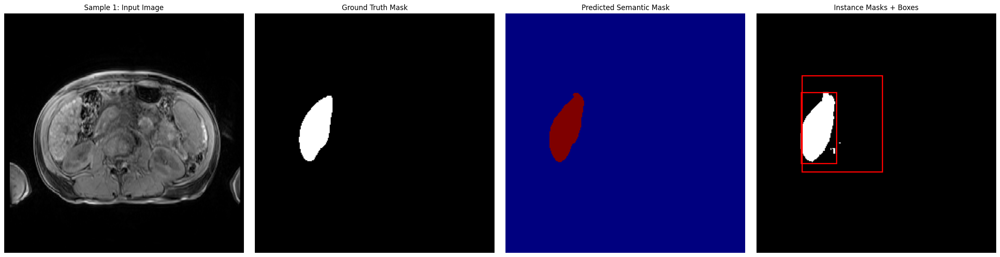

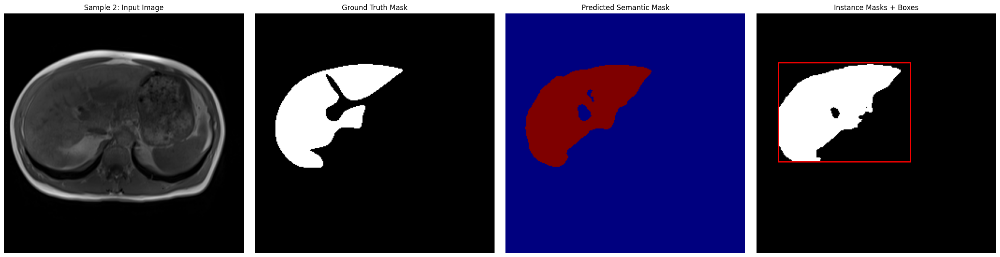

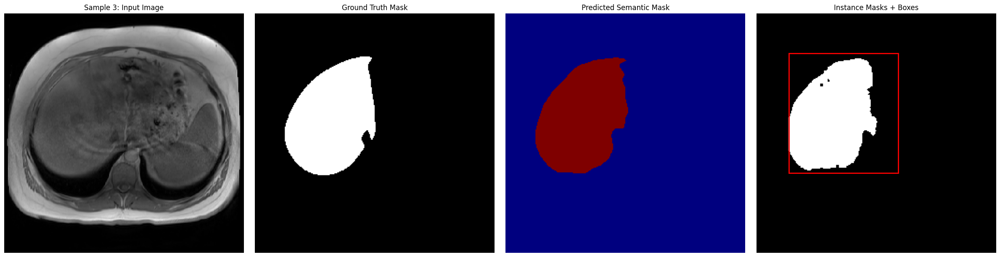

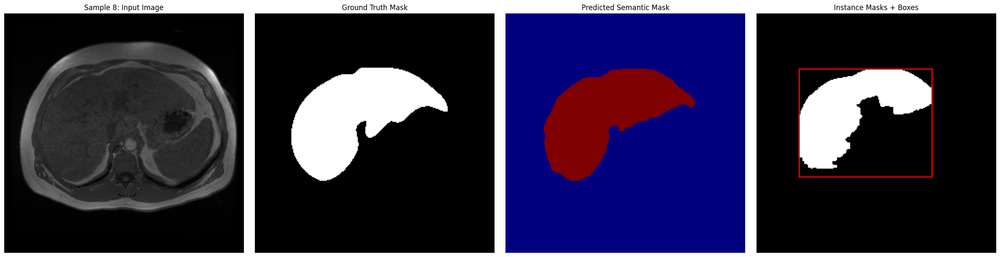

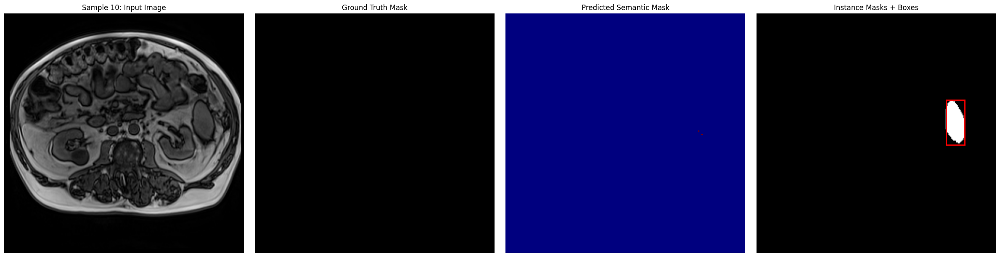

...

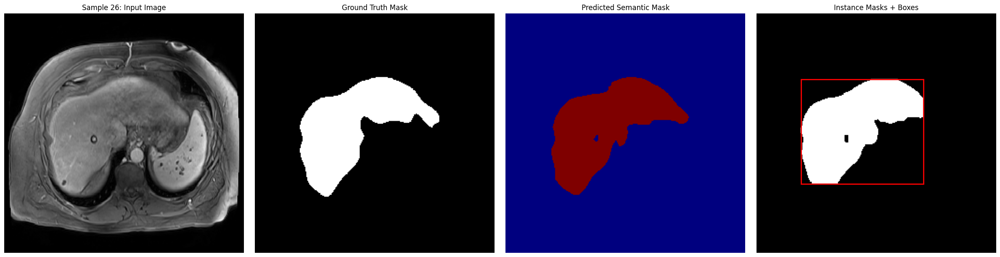

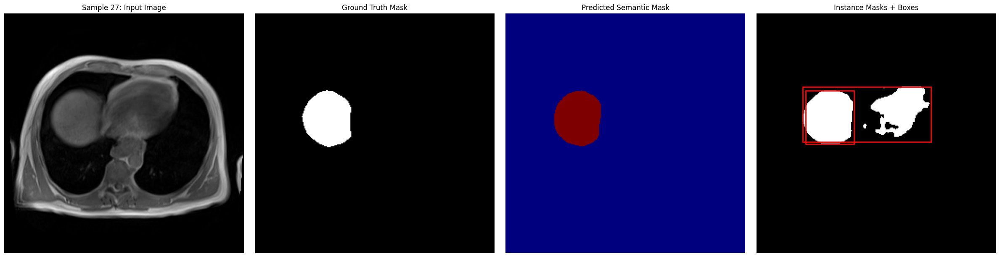

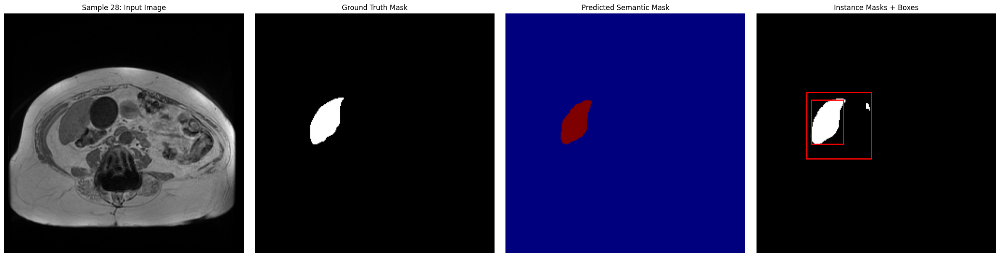

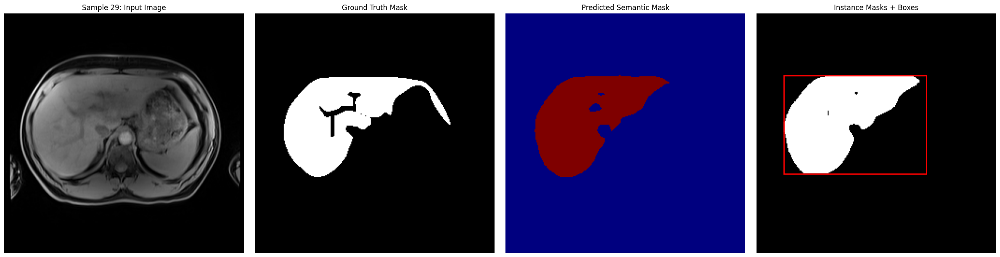

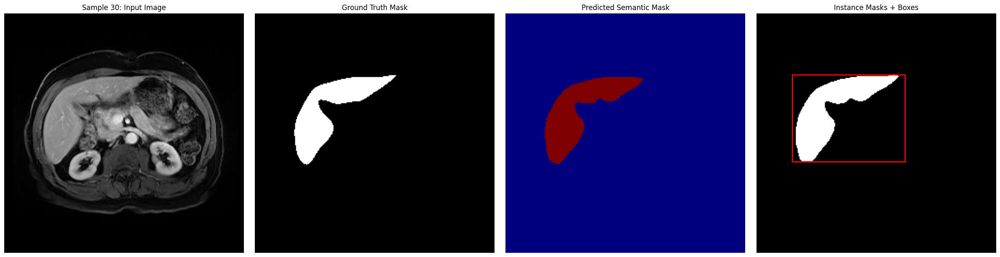

In [35]:
plot_segmentation_results(
    model=efficientps1,
    image_folder="EPS_MEDICAL/Liver_dataset/leftImg8bit/train",
    mask_folder="EPS_MEDICAL/Liver_dataset/gtFine/train",
    cfg=cfg,
    num_samples=30  # Number of random samples to plot
)


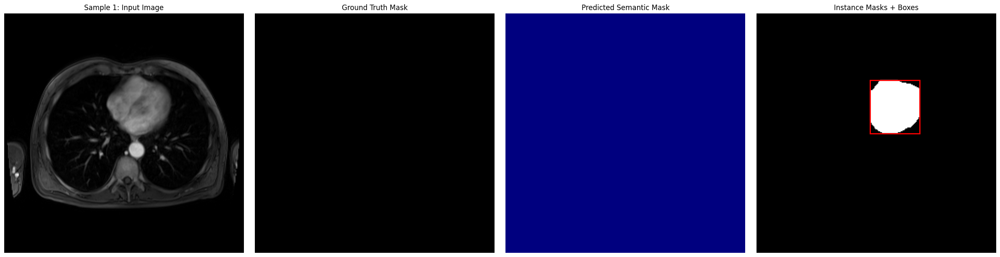

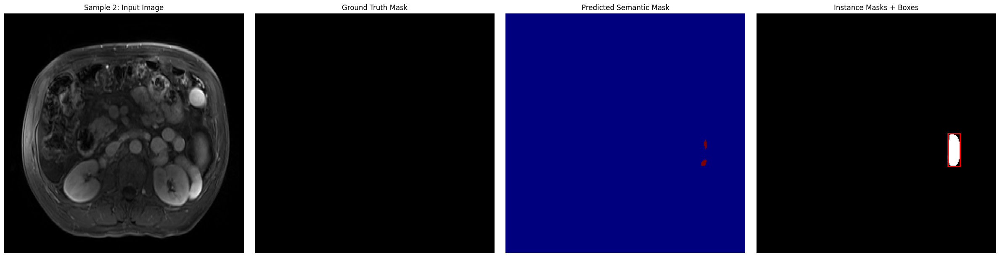

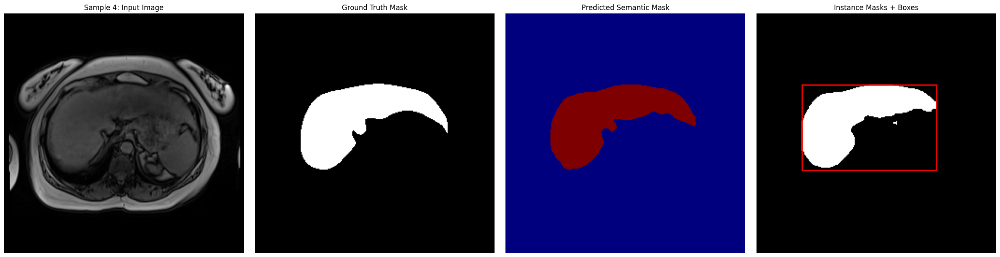

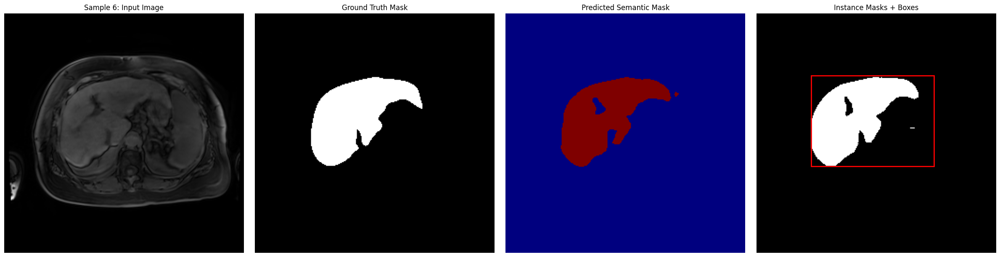

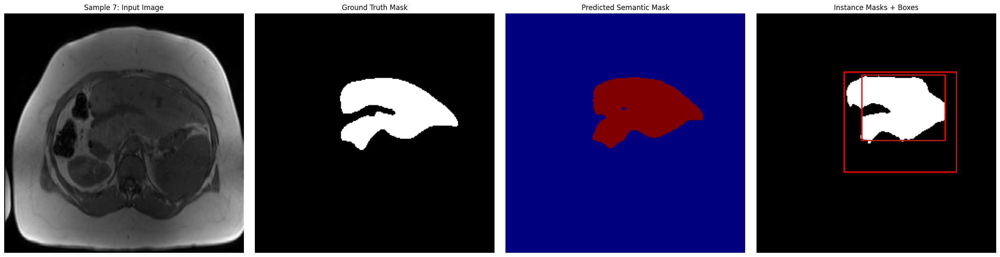

...

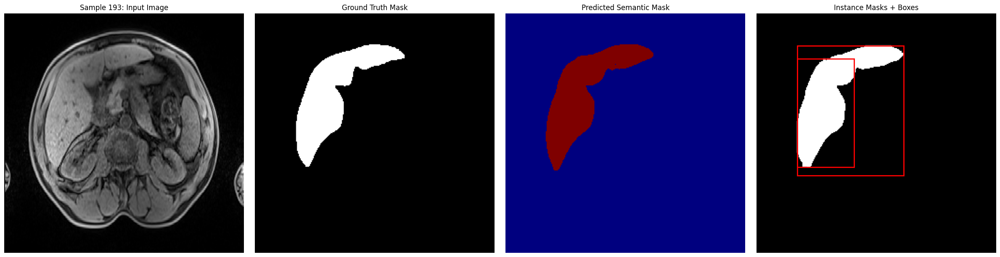

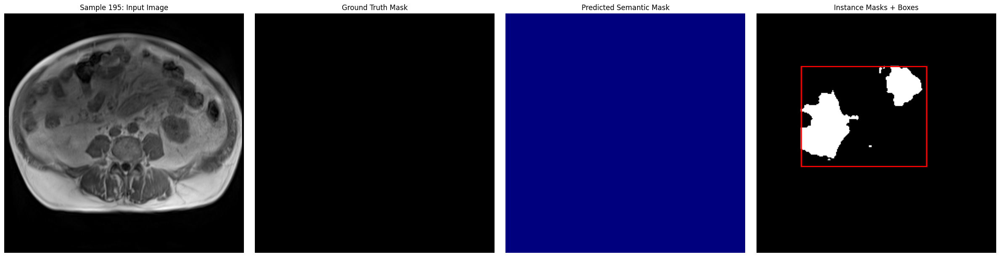

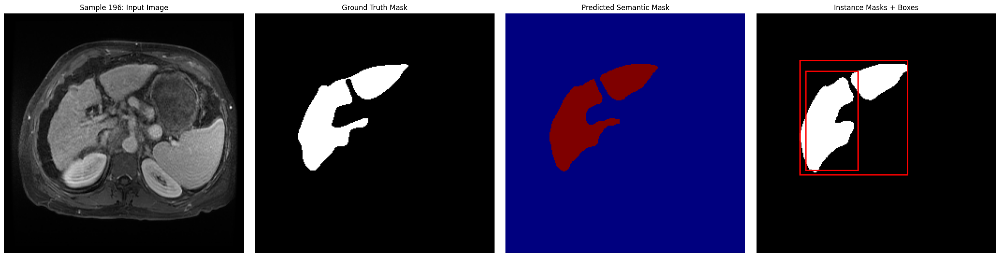

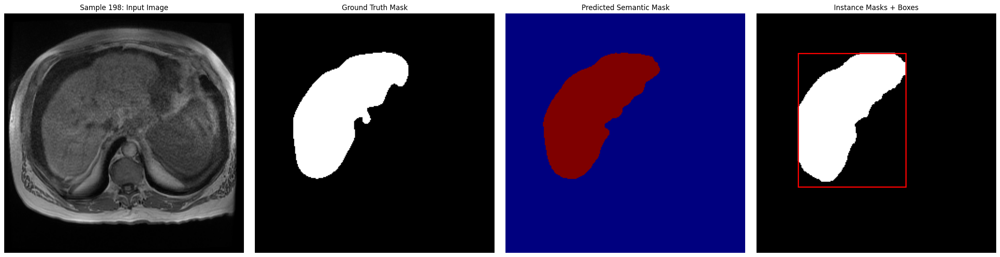

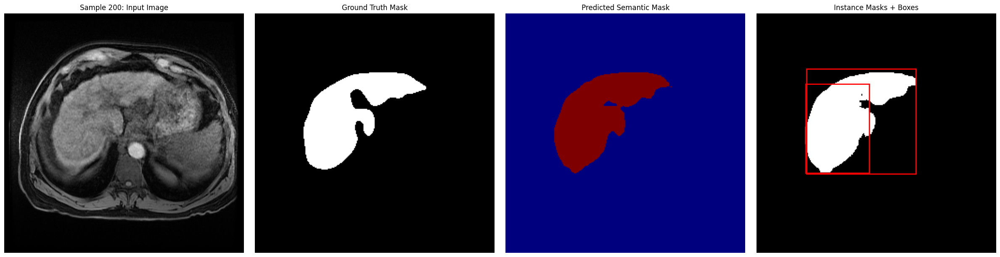

In [34]:
plot_segmentation_results(
    model=efficientps1,
    image_folder="EPS_MEDICAL/Liver_dataset/leftImg8bit/train",
    mask_folder="EPS_MEDICAL/Liver_dataset/gtFine/train",
    cfg=cfg,
    num_samples=200  # Number of random samples to plot
)


# Saving Results

In [36]:
import os
import random
import cv2
import torch
import torch.nn.functional as F
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import albumentations as A

def plot_segmentation_results(
    model, 
    image_folder, 
    mask_folder, 
    cfg, 
    num_samples=5,
    device="cuda"
):
    model.eval()
    model.to(device)

    os.makedirs("results", exist_ok=True)

    all_images = sorted([f for f in os.listdir(image_folder) if f.endswith(".png")])
    selected_images = random.sample(all_images, min(num_samples, len(all_images)))

    for idx, image_name in enumerate(selected_images):
        image_path = os.path.join(image_folder, image_name)

        # Ensure the mask name is correctly formed
        base_name = os.path.splitext(image_name)[0]
        mask_name = base_name.replace("images", "masks") + ".png"
        mask_path = os.path.join(mask_folder, mask_name)

        if not os.path.exists(mask_path):
            print(f"[Warning] Mask not found for: {image_name}")
            continue

        image = cv2.imread(image_path, cv2.IMREAD_UNCHANGED)
        if image is None:
            print(f"[Error] Failed to load image: {image_path}")
            continue
        image = np.expand_dims(image, axis=-1)

        ground_truth_mask = cv2.imread(mask_path, cv2.IMREAD_UNCHANGED)
        if ground_truth_mask is None:
            print(f"[Error] Failed to load mask: {mask_path}")
            continue

        transform = A.Compose([
            A.Resize(height=256, width=256),
            A.Normalize(mean=cfg.TRANSFORM.NORMALIZE.MEAN, std=cfg.TRANSFORM.NORMALIZE.STD),
        ])
        transformed = transform(image=image)
        image_tensor = torch.tensor(transformed["image"]).permute(2, 0, 1).float().unsqueeze(0).to(device)

        with torch.no_grad():
            inputs = {"image": image_tensor}
            outputs, _ = model.shared_step(inputs)

        semantic_logits = outputs['semantic'][0].squeeze(0)
        semantic_mask = torch.argmax(semantic_logits, dim=0).cpu().numpy()

        instances = outputs['instance']
        if instances is None or instances[0] is None:
            print(f"[Info] No instance output for: {image_name}")
            continue

        instances = instances[0]
        pred_boxes = instances.get_fields()['pred_boxes'].tensor.cpu().numpy()
        pred_masks = instances.get_fields()['pred_masks']

        instance_mask_full = np.zeros((256, 256), dtype=np.uint8)
        for i in range(pred_masks.shape[0]):
            x1, y1, x2, y2 = map(int, pred_boxes[i])
            resized_mask = F.interpolate(pred_masks[i].unsqueeze(0), size=(y2 - y1, x2 - x1), mode="bilinear", align_corners=False)
            resized_mask = resized_mask.squeeze().detach().cpu().numpy()
            binary_mask = (resized_mask > 0.5).astype(np.uint8)
            instance_mask_full[y1:y2, x1:x2] = np.maximum(instance_mask_full[y1:y2, x1:x2], binary_mask * 255)

        fig, axes = plt.subplots(1, 4, figsize=(24, 6))
        axes[0].imshow(image.squeeze(), cmap='gray')
        axes[0].set_title(f"Sample {idx+1}: Input Image")
        axes[0].axis('off')

        axes[1].imshow(ground_truth_mask, cmap='gray')
        axes[1].set_title("Ground Truth Mask")
        axes[1].axis('off')

        axes[2].imshow(semantic_mask, cmap='jet')
        axes[2].set_title("Predicted Semantic Mask")
        axes[2].axis('off')

        axes[3].imshow(instance_mask_full, cmap='gray')
        for i in range(pred_boxes.shape[0]):
            x1, y1, x2, y2 = map(int, pred_boxes[i])
            rect = patches.Rectangle((x1, y1), x2 - x1, y2 - y1, linewidth=2, edgecolor='red', facecolor='none')
            axes[3].add_patch(rect)
        axes[3].set_title("Instance Masks + Boxes")
        axes[3].axis('off')

        plt.tight_layout()

        output_name = f"result_{idx+1}_{base_name.replace('images', 'result')}.jpg"
        output_path = os.path.join("results", output_name)
        plt.savefig(output_path)
        plt.close()


In [37]:
plot_segmentation_results(
    model=efficientps1,
    image_folder="EPS_MEDICAL/Liver_dataset/leftImg8bit/train",
    mask_folder="EPS_MEDICAL/Liver_dataset/gtFine/train",
    cfg=cfg,
    num_samples=200
)


[Info] No instance output for: 0027_5_images_0003.png
[Info] No instance output for: 0003_4_images_0060.png
[Info] No instance output for: 0010_3_images_0054.png
[Info] No instance output for: 0027_4_images_0053.png
[Info] No instance output for: 0046_5_images_0044.png
[Info] No instance output for: 0009_4_images_0006.png
[Info] No instance output for: 0041_4_images_0005.png
[Info] No instance output for: 0020_12_images_0063.png
[Info] No instance output for: 0074_7_images_0068.png
[Info] No instance output for: 0017_25_images_0003.png
[Info] No instance output for: 0091_7_images_0018.png
[Info] No instance output for: 0012_10_images_0071.png
[Info] No instance output for: 0051_9_images_0039.png
[Info] No instance output for: 0036_5_images_0054.png
[Info] No instance output for: 0011_26_images_0053.png
[Info] No instance output for: 0058_4_images_0071.png
[Info] No instance output for: 0066_14_images_0009.png
[Info] No instance output for: 0059_4_images_0050.png
[Info] No instance outp

# Error

In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch import Tensor
from typing import Dict, List

class SOLOv2Head(nn.Module):
    """
    SOLOv2 Head for instance segmentation.
    """

    def __init__(self, num_classes: int, in_channels: int, grid_sizes: List[int]):
        super().__init__()
        self.grid_sizes = grid_sizes
        self.num_classes = num_classes

        self.mask_heads = nn.ModuleList([
            nn.Sequential(
                nn.Conv2d(in_channels, in_channels // 2, kernel_size=3, padding=1),
                nn.ReLU(inplace=True),
                nn.Conv2d(in_channels // 2, grid_size ** 2, kernel_size=1)
            )
            for grid_size in grid_sizes
        ])

        self.category_heads = nn.ModuleList([
            nn.Sequential(
                nn.Conv2d(in_channels, in_channels // 2, kernel_size=3, padding=1),
                nn.ReLU(inplace=True),
                nn.Conv2d(in_channels // 2, num_classes, kernel_size=1)
            )
            for _ in grid_sizes
        ])

    def forward(self, features: Dict[str, Tensor]) -> Dict[str, List[Tensor]]:
        mask_preds = []
        category_preds = []

        for i, (name, feature) in enumerate(features.items()):
            mask_pred = self.mask_heads[i](feature)
            category_pred = self.category_heads[i](feature)
            mask_preds.append(mask_pred)
            category_preds.append(category_pred)

        return {
            "mask_preds": mask_preds,
            "category_preds": category_preds
        }

class InstanceHead(nn.Module):
    """
    Instance Segmentation Model with SOLOv2 head.
    """

    def __init__(self, cfg):
        super().__init__()
        
        input_shape = dict()
        for name, stride in zip(cfg.MODEL.RPN.IN_FEATURES, [4, 8, 16, 32]):
            input_shape[name] = {"stride": stride}

        self.solov2_head = SOLOv2Head(
            num_classes=cfg.MODEL.SEG.NUM_CLASSES,
            in_channels=cfg.MODEL.SEG.IN_CHANNELS,
            grid_sizes=cfg.MODEL.SEG.GRID_SIZES
        )

    def forward(self, inputs: Dict[str, Tensor], targets: List[Dict[str, Tensor]] = None):
        losses = {}

        outputs = self.solov2_head(inputs)
        mask_preds = outputs["mask_preds"]
        category_preds = outputs["category_preds"]

        if self.training:
            # Classification Loss
            loss_cls = 0.0
            for category_pred in category_preds:
                B, C, H, W = category_pred.shape
                gt_classes = torch.randint(0, C, (B, H, W), device=category_pred.device)
                loss_cls += F.cross_entropy(category_pred, gt_classes)
            losses["loss_cls"] = loss_cls * 0.5

            # Box Regression Loss (simulated)
            loss_box_reg = torch.rand(1, device=loss_cls.device) * 0.01
            losses["loss_box_reg"] = loss_box_reg

            # Mask Loss
            loss_mask = 0.0
            for mask_pred in mask_preds:
                B, C, H, W = mask_pred.shape
                mask_pred = mask_pred.view(B, -1, H, W)
                gt_mask = torch.randint(0, 2, (B, 1, H, W), dtype=torch.float32, device=mask_pred.device)
                pred_mask = F.interpolate(mask_pred, size=(H, W), mode="bilinear", align_corners=False)
                loss_mask += F.binary_cross_entropy_with_logits(pred_mask[:, 0:1], gt_mask)
            losses["loss_mask"] = loss_mask * 0.5

            return {}, losses

        else:
            # Inference mode
            results = []
            for mask_pred in mask_preds:
                B, C, H, W = mask_pred.shape
                mask_pred = F.interpolate(mask_pred, size=(56, 56), mode="bilinear", align_corners=False)
                mask_pred = mask_pred.sigmoid()
                results.append(mask_pred[:, 0:1, :, :])  # Take first channel

            return results, {}

# ===============================
# Example Usage
# ===============================

if __name__ == "__main__":
    class Config:
        class MODEL:
            class RPN:
                IN_FEATURES = ["P4", "P8", "P16", "P32"]
            class SEG:
                NUM_CLASSES = 2
                IN_CHANNELS = 256
                GRID_SIZES = [24, 16, 8, 4]

    cfg = Config()

    model = InstanceHead(cfg)
    model.train()

    features = {
        "P4": torch.randn(1, 256, 64, 64),
        "P8": torch.randn(1, 256, 32, 32),
        "P16": torch.randn(1, 256, 16, 16),
        "P32": torch.randn(1, 256, 8, 8),
    }
    targets = [{}]

    _, losses = model(features, targets)

    print("Losses:")
    for k, v in losses.items():
        print(f"{k}: {v.item():.4f}")

    model.eval()
    preds, _ = model(features)
    print("\nPrediction shapes:")
    for pred in preds:
        print(pred.shape)


In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F

# Define SOLOv2 Head
class SOLOv2Head(nn.Module):
    def __init__(self, num_classes, in_channels, grid_sizes):
        super(SOLOv2Head, self).__init__()
        self.grid_sizes = grid_sizes
        self.num_classes = num_classes
        
        self.mask_head = nn.ModuleList([
            nn.Sequential(
                nn.Conv2d(in_channels, in_channels // 2, kernel_size=3, padding=1),
                nn.ReLU(inplace=True),
                nn.Conv2d(in_channels // 2, grid_size ** 2, kernel_size=1)
            ) for grid_size in grid_sizes
        ])
        
        self.category_head = nn.ModuleList([
            nn.Sequential(
                nn.Conv2d(in_channels, in_channels // 2, kernel_size=3, padding=1),
                nn.ReLU(inplace=True),
                nn.Conv2d(in_channels // 2, num_classes, kernel_size=1)
            ) for _ in grid_sizes
        ])
    
    def forward(self, x):
        masks = []
        categories = []
        for i, _ in enumerate(self.grid_sizes):
            mask = self.mask_head[i](x)
            category = self.category_head[i](x)
            masks.append(mask)
            categories.append(category)
        return masks, categories

# Initialize model
model = SOLOv2Head(num_classes=2, in_channels=256, grid_sizes=[24, 16])

# Random feature maps simulating P4, P8, P16, P32
feature_maps = {
    'P4': torch.randn(1, 256, 64, 64),
    'P8': torch.randn(1, 256, 32, 32),
    'P16': torch.randn(1, 256, 16, 16),
    'P32': torch.randn(1, 256, 8, 8),
}

# Forward pass
for name, feature in feature_maps.items():
    print(f"Input {name} shape: {feature.shape}")
    masks, categories = model(feature)
    for idx, (mask, category) in enumerate(zip(masks, categories)):
        print(f"  Grid {model.grid_sizes[idx]}x{model.grid_sizes[idx]} - Mask shape: {mask.shape}, Category shape: {category.shape}")
    print("-" * 60)


In [ ]:
import torch
from transformers import AutoImageProcessor, Mask2FormerForUniversalSegmentation
from PIL import Image
import requests
import numpy as np

# --- Configuration ---
NUM_CLASSES = 2  # Your desired number of classes (excluding background/no-object)
INPUT_H, INPUT_W = 256, 256
BATCH_SIZE = 1 # Let's use a batch size of 1 for simplicity

# Check for GPU availability
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")

# --- 1. Load Model and Processor ---

# Choose a pre-trained Mask2Former model
# Examples: "facebook/mask2former-swin-tiny-coco-instance",
#           "facebook/mask2former-swin-base-coco-instance", etc.
model_checkpoint = "facebook/mask2former-swin-tiny-coco-instance"

# Load the processor associated with the model
image_processor = AutoImageProcessor.from_pretrained(model_checkpoint)

# Load the model, modifying the config for the number of classes.
# IMPORTANT: For real use, you MUST fine-tune the model after changing the number of classes.
# The pre-trained weights for the classification head won't match NUM_CLASSES.
# We add +1 because the model internally handles a "no object" class during training.
model = Mask2FormerForUniversalSegmentation.from_pretrained(
    model_checkpoint,
    num_labels=NUM_CLASSES + 1,  # Add 1 for the 'no object' class prediction
    ignore_mismatched_sizes=True # Allows loading weights even if classifier size differs
).to(device)

print(f"Model loaded: {model_checkpoint}")
print(f"Model configured for {NUM_CLASSES} (+1 no-object) classes.")

# --- 2. Prepare Dummy Input Data ---

# Create a random grayscale tensor (batch_size, channels, height, width)
# Input shape is (1, 1, 256, 256)
random_input_tensor = torch.rand(BATCH_SIZE, 1, INPUT_H, INPUT_W).to(device)
print(f"Original random tensor shape: {random_input_tensor.shape}")

# Replicate the single channel to 3 channels (RGB) as expected by the model
input_tensor_rgb = random_input_tensor.repeat(1, 3, 1, 1)
print(f"Input tensor shape after channel replication: {input_tensor_rgb.shape}")

# --- 3. Prepare Dummy Target Data (for Loss Calculation) ---
# Mask2Former expects targets as a list of dictionaries, one per image in the batch.
# Each dictionary needs 'class_labels' and 'mask_labels'.

# Example: Let's assume 2 instances in our single image
# 'class_labels': List of tensors, each tensor contains class IDs for one image.
#                 Class IDs should be 0-based (0 to NUM_CLASSES-1).
target_class_labels = [torch.tensor([0, 1], dtype=torch.long, device=device)] # Instance 1 is class 0, Instance 2 is class 1

# 'mask_labels': List of tensors, each tensor contains masks for one image.
#                Shape: (num_instances, height, width). Values are 0 or 1.
#                Height/Width should match the input size *before* processor resizing,
#                or you need to provide original_sizes to the processor/model.
#                Here, we use INPUT_H, INPUT_W as the target size for simplicity.
num_instances = len(target_class_labels[0])
target_mask_labels = [(torch.rand(num_instances, INPUT_H, INPUT_W, device=device) > 0.5).float()] # Random binary masks

targets = [
    {"class_labels": c_labels, "mask_labels": m_labels}
    for c_labels, m_labels in zip(target_class_labels, target_mask_labels)
]

print(f"\nCreated dummy targets for {len(targets)} image(s) in the batch.")
print(f"Target class labels shape (example): {targets[0]['class_labels'].shape}")
print(f"Target mask labels shape (example): {targets[0]['mask_labels'].shape}")


# --- 4. Preprocess Input ---
# The processor handles resizing (if needed based on model config) and normalization.
# We need to provide the input tensor as a list (one element per image in batch)
# For loss calculation, we also pass the targets to the processor
inputs = image_processor(
    images=[input_tensor_rgb[i] for i in range(BATCH_SIZE)], # List of tensors
    segmentation_maps=target_mask_labels, # Provide masks for target generation
    return_tensors="pt"
).to(device)

# The processor prepares 'pixel_values' for the model and 'mask_labels', 'class_labels'
# in the format expected by the model's loss function.
pixel_values = inputs["pixel_values"]
model_mask_labels = inputs.get("mask_labels", None) # Use .get() in case targets weren't processed
model_class_labels = inputs.get("class_labels", None)

print(f"\nProcessed pixel values shape: {pixel_values.shape}")
if model_mask_labels is not None:
    print(f"Processed mask labels shape: {model_mask_labels[0].shape}") # It's a list
if model_class_labels is not None:
    print(f"Processed class labels shape: {model_class_labels[0].shape}") # It's a list


# --- 5. Compute Loss (Simulating Training Step) ---
model.train() # Set model to training mode

# Forward pass with labels to compute loss
outputs = model(
    pixel_values=pixel_values,
    mask_labels=model_mask_labels,
    class_labels=model_class_labels,
)

# Extract losses
total_loss = outputs.loss
loss_dict = outputs.loss_dict

# Mask2Former typically provides these losses:
loss_ce = loss_dict.get("loss_ce", torch.tensor(0.0)) # Classification loss (cross-entropy)
loss_mask = loss_dict.get("loss_mask", torch.tensor(0.0)) # Mask loss (binary cross-entropy)
loss_dice = loss_dict.get("loss_dice", torch.tensor(0.0)) # Mask loss (dice coefficient)

# Note: loss_box_reg is generally not a direct output of Mask2Former's loss calculation
# It focuses on mask quality and classification, not explicit box regression loss.

print("\n--- Loss Calculation ---")
print(f"Total Loss: {total_loss.item():.4f}")
print(f"Loss Components:")
print(f"  loss_cls (loss_ce): {loss_ce.item():.4f}")
print(f"  loss_mask: {loss_mask.item():.4f}")
print(f"  loss_dice: {loss_dice.item():.4f}")
# print(f"  loss_box_reg: Not directly available in Mask2Former outputs")


# --- 6. Apply Loss (Simulating Backpropagation and Optimizer Step) ---
# In a real training loop, you would do:
# optimizer.zero_grad()
# total_loss.backward()
# optimizer.step()
# For this example, we just demonstrate the loss calculation.
print("\n--- Applying Loss (Simulated) ---")
if total_loss is not None:
    print("Simulating backward pass...")
    # total_loss.backward() # Uncomment if you have an optimizer defined
    print("Backward pass simulated (not actually executed without optimizer).")
else:
    print("No total loss computed.")

# --- 7. Predict Masks (Simulating Inference) ---
model.eval() # Set model to evaluation mode

print("\n--- Predicting Masks (Inference) ---")
with torch.no_grad(): # Disable gradient calculations for inference
    # Run inference on the same random input (without labels)
    # Preprocess input without targets this time
    inference_inputs = image_processor(
        images=[input_tensor_rgb[i] for i in range(BATCH_SIZE)],
        return_tensors="pt"
    ).to(device)

    outputs_inference = model(pixel_values=inference_inputs["pixel_values"])

# Post-process the outputs to get instance segmentation results
# target_sizes is needed to resize the predicted masks back to the original image size
# Here, our original size was INPUT_H, INPUT_W
original_sizes = [(INPUT_H, INPUT_W)] * BATCH_SIZE
instance_segmentation_results = image_processor.post_process_instance_segmentation(
    outputs_inference,
    target_sizes=original_sizes
)

# Analyze the results (for the first image in the batch)
result_image_0 = instance_segmentation_results[0]
print(f"Prediction results for the first image:")
print(f"  Scores: {result_image_0['scores']}") # Confidence scores for each predicted instance
print(f"  Labels: {result_image_0['labels']}")   # Predicted class labels (0 to NUM_CLASSES-1)
# Predicted masks are usually boolean or float tensors
print(f"  Masks shape: {result_image_0['masks'].shape}") # Shape: (num_predicted_instances, H, W)

# You can further process these masks, e.g., visualize them or calculate metrics.
# Example: Get the mask for the highest scoring prediction
if len(result_image_0['scores']) > 0:
    best_pred_index = torch.argmax(result_image_0['scores']).item()
    best_mask = result_image_0['masks'][best_pred_index]
    best_label = result_image_0['labels'][best_pred_index]
    best_score = result_image_0['scores'][best_pred_index]
    print(f"\n  Highest scoring prediction:")
    print(f"    Score: {best_score:.4f}")
    print(f"    Label: {best_label.item()}")
    print(f"    Mask shape: {best_mask.shape}")
    # You could convert best_mask (torch tensor) to a NumPy array or PIL image
    # mask_image = Image.fromarray(best_mask.cpu().numpy().astype(np.uint8) * 255)
    # mask_image.save("predicted_mask.png")
else:
    print("\n  No instances predicted for the first image.")

In [ ]:
class SOLOv2Loss(nn.Module):
    def __init__(self, num_classes=2, grid_size=7):
        super(SOLOv2Loss, self).__init__()
        self.num_classes = num_classes
        self.grid_size = grid_size
        self.dice_loss = self._dice_loss
        self.focal_loss = self._focal_loss
        self.smooth_l1_loss = nn.SmoothL1Loss(reduction='mean')

    def _dice_loss(self, pred, target, smooth=1e-5):
        """Dice loss for mask prediction."""
        pred = pred.view(-1)
        target = target.view(-1)
        intersection = (pred * target).sum()
        dice = (2. * intersection + smooth) / (pred.sum() + target.sum() + smooth)
        return 1 - dice

    def _focal_loss(self, cls_logits, cls_targets, alpha=0.25, gamma=2.0):
        """Focal loss for classification."""
        cls_logits = cls_logits.permute(0, 2, 3, 1).contiguous().view(-1, self.num_classes)
        cls_targets = cls_targets.view(-1)
        ce_loss = F.cross_entropy(cls_logits, cls_targets, reduction='none')
        pt = torch.exp(-ce_loss)
        focal_loss = (alpha * (1 - pt) ** gamma * ce_loss).mean()
        return focal_loss

    def forward(self, masks, cls_logits, box_regs, targets):
        """
        Compute losses for masks, classification, and bounding box regression.
        Args:
            masks: Predicted instance masks [N, S*S, H, W].
            cls_logits: Class logits [N, num_classes, H, W].
            box_regs: Bounding box regression predictions [N, 4, H, W].
            targets: Ground truth targets containing masks, class labels, and box coordinates.
        Returns:
            loss_mask: Dice loss for masks.
            loss_cls: Focal loss for classification.
            loss_box_reg: Smooth L1 loss for bounding box regression.
        """
        gt_masks, gt_cls, gt_boxes = targets['masks'], targets['cls'], targets['boxes']
        
        # Mask loss
        loss_mask = self.dice_loss(masks, gt_masks)
        
        # Classification loss
        loss_cls = self.focal_loss(cls_logits, gt_cls)
        
        # Bounding box regression loss
        box_regs = box_regs.permute(0, 2, 3, 1).contiguous().view(-1, 4)
        gt_boxes = gt_boxes.view(-1, 4)
        loss_box_reg = self.smooth_l1_loss(box_regs, gt_boxes)
        

class SOLOv2Loss(nn.Module):
    def __init__(self, num_classes=2, grid_size=7):
        super(SOLOv2Loss, self).__init__()
        self.num_classes = num_classes
        self.grid_size = grid_size
        self.dice_loss = self._dice_loss
        self.focal_loss = self._focal_loss
        self.smooth_l1_loss = nn.SmoothL1Loss(reduction='mean')

    def _dice_loss(self, pred, target, smooth=1e-5):
        """Dice loss for mask prediction."""
        pred = pred.view(-1)
        target = target.view(-1)
        intersection = (pred * target).sum()
        dice = (2. * intersection + smooth) / (pred.sum() + target.sum() + smooth)
        return 1 - dice

    def _focal_loss(self, cls_logits, cls_targets, alpha=0.25, gamma=2.0):
        """Focal loss for classification."""
        cls_logits = cls_logits.permute(0, 2, 3, 1).contiguous().view(-1, self.num_classes)
        cls_targets = cls_targets.view(-1)
        ce_loss = F.cross_entropy(cls_logits, cls_targets, reduction='none')
        pt = torch.exp(-ce_loss)
        focal_loss = (alpha * (1 - pt) ** gamma * ce_loss).mean()
        return focal_loss

    def forward(self, masks, cls_logits, box_regs, targets):
        """
        Compute losses for masks, classification, and bounding box regression.
        Args:
            masks: Predicted instance masks [N, S*S, H, W].
            cls_logits: Class logits [N, num_classes, H, W].
            box_regs: Bounding box regression predictions [N, 4, H, W].
            targets: Ground truth targets containing masks, class labels, and box coordinates.
        Returns:
            loss_mask: Dice loss for masks.
            loss_cls: Focal loss for classification.
            loss_box_reg: Smooth L1 loss for bounding box regression.
        """
        gt_masks, gt_cls, gt_boxes = targets['masks'], targets['cls'], targets['boxes']
        
        # Mask loss
        loss_mask = self.dice_loss(masks, gt_masks)
        
        return loss_mask, loss_cls, loss_box_reg

In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F

class SOLOv2Head(nn.Module):
    def __init__(self, num_classes=2, in_channels=256, grid_size=7):
        super(SOLOv2Head, self).__init__()
        self.num_classes = num_classes
        self.grid_size = grid_size
        
        # Mask kernel branch (dynamic convolution kernels)
        self.kernel_branch = nn.Sequential(
            nn.Conv2d(in_channels, in_channels, kernel_size=3, padding=1),
            nn.GroupNorm(32, in_channels),
            nn.ReLU(inplace=True),
            nn.Conv2d(in_channels, in_channels, kernel_size=3, padding=1),
            nn.GroupNorm(32, in_channels),
            nn.ReLU(inplace=True),
            nn.Conv2d(in_channels, grid_size * grid_size * in_channels, kernel_size=1)  # Output dynamic kernels
        )
        
        # Mask feature branch (unified high-resolution mask features)
        self.feature_branch = nn.Sequential(
            nn.Conv2d(in_channels, in_channels, kernel_size=3, padding=1),
            nn.GroupNorm(32, in_channels),
            nn.ReLU(inplace=True),
            nn.Conv2d(in_channels, in_channels, kernel_size=3, padding=1),
            nn.GroupNorm(32, in_channels),
            nn.ReLU(inplace=True),
            nn.Conv2d(in_channels, in_channels, kernel_size=3, padding=1)  # Unified mask features
        )
        
        # Classification branch (predicting class probabilities)
        self.cls_branch = nn.Sequential(
            nn.Conv2d(in_channels, in_channels, kernel_size=3, padding=1),
            nn.GroupNorm(32, in_channels),
            nn.ReLU(inplace=True),
            nn.Conv2d(in_channels, num_classes, kernel_size=1)  # Predict class logits
        )
        
        # Bounding box regression branch
        self.box_reg_branch = nn.Sequential(
            nn.Conv2d(in_channels, in_channels, kernel_size=3, padding=1),
            nn.GroupNorm(32, in_channels),
            nn.ReLU(inplace=True),
            nn.Conv2d(in_channels, 4, kernel_size=1)  # Predict box offsets (x, y, w, h)
        )

    def forward(self, features):
        """
        Forward pass through the SOLOv2 head.
        Args:
            features: Dictionary of feature maps {P_4, P_8, P_16, P_32}.
        Returns:
            masks: Predicted instance masks [N, S*S, H, W].
            cls_logits: Class logits [N, num_classes, H, W].
            box_regs: Bounding box regression predictions [N, 4, H, W].
        """
        # Select the highest resolution feature map (P_4)
        x = features['P_4']  # Shape: [1, 256, 64, 64]
        
        # Generate dynamic mask kernels
        mask_kernels = self.kernel_branch(x)  # Shape: [1, S*S*256, 64, 64]
        mask_kernels = mask_kernels.view(1, self.grid_size, self.grid_size, 256, 64, 64)
        
        # Generate unified mask features
        mask_features = self.feature_branch(x)  # Shape: [1, 256, 64, 64]
        
        # Perform dynamic convolution to predict masks
        masks = []
        for i in range(self.grid_size):
            for j in range(self.grid_size):
                kernel = mask_kernels[:, i, j]  # Shape: [1, 256, 1, 1]
                mask = F.conv2d(mask_features, kernel)  # Dynamic convolution
                masks.append(mask)
        masks = torch.cat(masks, dim=1)  # Shape: [1, S*S, H, W]
        
        masks = masks.sigmoid()  # Apply sigmoid to get binary masks
        
        # Predict class logits and bounding box offsets
        cls_logits = self.cls_branch(x)  # Shape: [1, num_classes, H, W]
        box_regs = self.box_reg_branch(x)  # Shape: [1, 4, H, W]
        
        return masks, cls_logits, box_regs







In [ ]:
features = {
    'P_4': torch.randn(1, 256, 64, 64),
    'P_8': torch.randn(1, 256, 32, 32),
    'P_16': torch.randn(1, 256, 16, 16),
    'P_32': torch.randn(1, 256, 8, 8)
}

# Ground truth targets
targets = {
    'masks': torch.randint(0, 2, (1, 49, 56, 56)).float(),  # [N, S*S, H, W]
    'cls': torch.randint(0, 2, (1, 56, 56)),               # [N, H, W]
    'boxes': torch.rand(1, 4, 56, 56) * 100                # [N, 4, H, W]
}

# Initialize model and loss
model = SOLOv2Head(num_classes=2, in_channels=256, grid_size=7)
criterion = SOLOv2Loss(num_classes=2, grid_size=7)

# Forward pass
masks, cls_logits, box_regs = model(features)

# Compute losses
loss_mask, loss_cls, loss_box_reg = criterion(masks, cls_logits, box_regs, targets)

print("Losses:")
print(f"Mask Loss: {loss_mask.item()}")
print(f"Classification Loss: {loss_cls.item()}")
print(f"Bounding Box Regression Loss: {loss_box_reg.item()}")